In [1]:
import numpy as np
import pandas as pd
import time
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mimg
from torchvision import datasets, models, transforms
import torch.nn.functional as F
import torchvision 
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader

In [2]:
!ls ../inputdd

ls: cannot access '../inputdd': No such file or directory


In [3]:
f = pd.read_csv('/home/michal/Documents/resnett/resnett/list_landmarks_align_celeba.csv').values[:,1:]

batch_size = 128
num_workers = 4
transform = transforms.Compose([transforms.ToTensor(),                                
                                transforms.Normalize(mean=[0.5], std=[0.5]),
                                transforms.Resize(size=[int(218/5), int(178/5)])])

dataset = ImageFolder('/home/michal/Documents/resnett/resnett/img_align_celeba/', transform)
# ds = DataLoader(dataset, batch_size=batch_size, shuffle=False)
# dl = DataLoader(torch.Tensor(f.astype(np.float64)), batch_size=BATCH_SIZE, shuffle=False)

train_loader = DataLoader(dataset=dataset,
                          batch_size=batch_size,
                          num_workers=num_workers,
                          drop_last=True)

# train_loader, valid_loader, test_loader


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


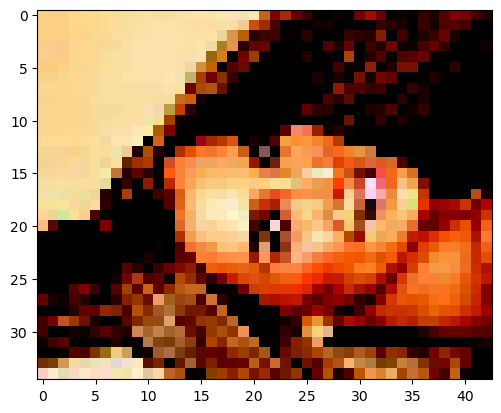

In [4]:
plt.imshow(next(iter(train_loader))[0][0].numpy().T)

In [5]:
def train_gan_v1(num_epochs, model,
                 latent_dim, train_loader, loss_fn=None,
                 logging_interval=100, b=batch_size,
                 save_model=None):
    print("training1")
    log_dict = {'train_generator_loss_per_batch': [],
                'train_discriminator_loss_per_batch': [],
                'train_discriminator_real_acc_per_batch': [],
                'train_discriminator_fake_acc_per_batch': [],
                'images_from_noise_per_epoch': []}
    
    torch.autograd.set_detect_anomaly(True)
    scaler1 = torch.cuda.amp.GradScaler()
    scaler2 = torch.cuda.amp.GradScaler()
    if loss_fn is None:
        loss_fn = F.binary_cross_entropy_with_logits
    autocast = torch.autocast 
    # Batch of latent (noise) vectors for
    # evaluating / visualizing the training progress
    # of the generator
    lr = 0.00001
    start_time = time.time()
    fixed_noise = torch.randn(b, 1, 1, latent_dim) # format NCHW
    for epoch in range(num_epochs):
                    
        optimizer_discr  = torch.optim.Adam(model.discriminator.parameters(),
                                       betas=(0.5, 0.999),
                                       lr=lr)

        optimizer_gen = torch.optim.Adam(model.generator.parameters(),
                                     betas=(0.5, 0.999),
                                     lr=lr)

        model.train()
        for batch_idx, (features,_) in enumerate(train_loader):
            batch_size = features.size(0)
            # batch_size = np.shape(next(iter(features))[1])

            # real images
            
            # generated (fake) images
            noise = torch.randn(batch_size, 1, 1, latent_dim, device='cuda:0')  # format NCHW
            model.generator = model.generator.to('cuda:0')
            with autocast(device_type='cuda', dtype=torch.float16):
                fake_images = model.generator_forward(noise)

            # model.generator = model.generator.detach()
            # noise = noise.detach()
            # --------------------------
            # Train Discriminator
            # --------------------------

            optimizer_discr.zero_grad()

            # get discriminator loss on fake images

            fake_labels = torch.zeros(batch_size, device='cuda:0') # fake label = 0
            model.discriminator = model.discriminator.to('cuda:0')

            with autocast(device_type='cuda', dtype=torch.float16):
                discr_pred_fake = model.discriminator_forward(fake_images).view(-1)
                fake_loss = loss_fn(discr_pred_fake, fake_labels)
            # fake_labels = fake_labels.detach()
            
            scaler1.scale(fake_loss).backward(retain_graph=True)
            
            # fake_loss.backward()
            
            real_images = features.to('cuda:0')
            real_labels = torch.ones(batch_size, device='cuda:0') # real label = 1

            # get discriminator loss on real images
            with autocast(device_type='cuda', dtype=torch.float16):
                discr_pred_real = model.discriminator_forward(real_images).view(-1) # Nx1 -> N
                real_loss = loss_fn(discr_pred_real, real_labels)
                discr_loss = 0.5*(real_loss + fake_loss)

            scaler1.scale(real_loss).backward(retain_graph=True)

            real_images = real_images.detach()
            real_labels = real_labels.detach()
            # real_loss.backward()


            # combined loss
            
            scaler1.scale(discr_loss).backward(retain_graph=True)
            # scaler.scale(discr_loss).backward(retain_graph=True)

            # optimizer_discr.step()
            scaler1.step(optimizer_discr)

            # --------------------------
            # Train Generator
            # --------------------------

            optimizer_gen.zero_grad()

            # get discriminator loss on fake images with flipped labels
            # for i in range(3):
            # noise = torch.randn(batch_size, 1, 1, latent_dim, device='cuda:0')  # format NCHW
            # fake_images = model.generator_forward(noise)

            flipped_fake_labels = real_labels.to('cuda:0') # here, fake label = 1
            with autocast(device_type='cuda', dtype=torch.float16):
                discr_pred_fake = model.discriminator_forward(fake_images.to('cuda:0')).view(-1)
                gener_loss = loss_fn(discr_pred_fake, flipped_fake_labels)
            scaler2.scale(gener_loss).backward(retain_graph=True)
            # scaler.scale(gener_loss).backward(retain_graph=True)

            # optimizer_discr.step()
            scaler2.step(optimizer_gen)
            scaler2.update()
            scaler1.update()

            flipped_fake_labels = flipped_fake_labels.detach() 
            discr_pred_fake = discr_pred_fake.detach()
            # gener_loss.backward()
            # gener_loss.backward(retain_graph=True)

            # optimizer_gen.step()
            # discr_pred_real = model.discriminator.detach() # Nx1 -> N

            # --------------------------
            # Logging
            # --------------------------   
            log_dict['train_generator_loss_per_batch'].append(gener_loss.item())
            log_dict['train_discriminator_loss_per_batch'].append(discr_loss.item())
            
            predicted_labels_real = torch.where(discr_pred_real.detach() > 0., 1., 0.)
            predicted_labels_fake = torch.where(discr_pred_fake.detach() > 0., 1., 0.)
            acc_real = (predicted_labels_real == real_labels).float().mean()*100.
            acc_fake = (predicted_labels_fake == fake_labels).float().mean()*100.
            log_dict['train_discriminator_real_acc_per_batch'].append(acc_real.item())
            log_dict['train_discriminator_fake_acc_per_batch'].append(acc_fake.item())         
            if not batch_idx % logging_interval:
                print('Epoch: %03d/%03d | Batch %03d/%03d | Gen/Dis Loss: %.4f/%.4f' 
                       % (epoch+1, num_epochs, batch_idx, 
                          len(train_loader), gener_loss.item(), discr_loss.item()))

        ### Save images for evaluation
#         with torch.no_grad():
#             fake_images = model.generator_forward(fixed_noise).detach().cpu()
#             log_dict['images_from_noise_per_epoch'].append(
#                 torchvision.utils.make_grid(fake_images, padding=2, normalize=True))
        with torch.no_grad():

            gen = model.generator.cpu()
            fake_images = gen(fixed_noise).detach().numpy()

        fig, ax = plt.subplots(10,10, figsize=(64, 48))
        for i in range(10):
            for j in range(10):
                ax[i,j].imshow(fake_images[i+10*j].T)
        plt.show()
        print('lol')
        print('Time elapsed: %.2f min' % ((time.time() - start_time)/60))

        
    print('Total Training Time: %.2f min' % ((time.time() - start_time)/60))
    
    if save_model is not None:
        torch.save(model.state_dict(), save_model)
    
    return log_dict


In [6]:
class blockx(nn.Module):
    def __init__(self, in_channels=10):
        super(blockx, self).__init__()

        self.avg0 = nn.AvgPool2d(5)
        self.conv0 = nn.Conv2d(in_channels=3, out_channels = 64, kernel_size=3, stride=1, padding=1)

        self.conv11 = nn.Conv2d(in_channels=64, out_channels = 64, kernel_size=3, stride=1, padding=1)
        self.conv21 = nn.Conv2d(in_channels=64, out_channels = 64, kernel_size=3, stride=1, padding=1)
        self.conv31 = nn.Conv2d(in_channels=64, out_channels = 64, kernel_size=1, stride=1, padding=0)

        
        self.bn11 = nn.BatchNorm2d(64)
        self.bn21 = nn.BatchNorm2d(64)
        self.relu = nn.ReLU()


        self.conv12 = nn.Conv2d(in_channels=64, out_channels = 64, kernel_size=3, stride=1, padding=1)
        self.conv22 = nn.Conv2d(in_channels=64, out_channels = 64, kernel_size=3, stride=1, padding=1)
        self.conv32 = nn.Conv2d(in_channels=64, out_channels = 64, kernel_size=1, stride=1, padding=0)

        
        self.bn12 = nn.BatchNorm2d(64)
        self.bn22 = nn.BatchNorm2d(64)
        self.relu = nn.ReLU(inplace=True)
        self.avg = nn.AdaptiveAvgPool2d((1,1))
        self.fc = nn.Linear(64, 1)

    def forward(self, x):

#         x = self.avg0(x)
        x = self.conv0(x)
        
        identity = x
        
        x = self.conv11(x)
        x = self.bn11(x)
        x = self.relu(x)
        x = self.conv21(x)
        x = self.bn21(x)
        identity = self.conv31(identity)
        x += identity
        x = self.relu(x)

        # identity = x

        # x = self.conv12(x)
        # x = self.bn12(x)
        # x = self.relu(x)
        # x = self.conv22(x)
        # x = self.bn22(x)
        # identity = self.conv32(identity)
        # x += identity.item()
        # x = self.relu(x)
        
        x = self.avg(x)
        x = x.reshape(x.shape[0],-1)
        
        x = self.fc(x)
        
        # 1505
        return x


In [7]:
class genx(nn.Module):
    def __init__(self, num_features=10, batch_size=128):
        super().__init__()
        # x = torch.Tensor(4, 1,1,10)
        self.fc = nn.Linear(num_features,3*int(218/5)*int(178/5))
        self.inc = 64
        self.conv0 = nn.ConvTranspose2d(3, self.inc, kernel_size=1, stride=1, padding=0)
        self.xd113 = nn.ConvTranspose2d(in_channels=self.inc,out_channels=self.inc,kernel_size=3, stride=1, padding=1)
        self.xd213 = nn.ConvTranspose2d(in_channels=self.inc,out_channels=self.inc,kernel_size=3, stride=2, padding=0)
        self.xd313 = nn.ConvTranspose2d(in_channels=self.inc,out_channels=self.inc,kernel_size=3, stride=2, padding=0)
        self.xd123 = nn.ConvTranspose2d(in_channels=self.inc,out_channels=self.inc,kernel_size=3, stride=1, padding=1)
        self.xd223 = nn.ConvTranspose2d(in_channels=self.inc,out_channels=self.inc,kernel_size=3, stride=2, padding=0)
        self.xd323 = nn.ConvTranspose2d(in_channels=self.inc,out_channels=self.inc,kernel_size=3, stride=2, padding=0)
        self.xd323 = nn.ConvTranspose2d(in_channels=self.inc,out_channels=self.inc,kernel_size=3, stride=2, padding=0)
        self.bn213 = nn.BatchNorm2d(self.inc)
        self.bn123 = nn.BatchNorm2d(self.inc)
        self.bn113 = nn.BatchNorm2d(self.inc)
        self.rl113 = nn.LeakyReLU(inplace=True)
        self.rl123 = nn.LeakyReLU(inplace=True)
        self.bn223 = nn.BatchNorm2d(self.inc)
        self.c = nn.ConvTranspose2d(64, 3, kernel_size=3, stride=2, padding=0)
        self.m = nn.AdaptiveAvgPool2d((43, 35))
        self.tanh = nn.Tanh()
    def forward(self, x):
        #blok3, część 1
        x = self.fc(x)
        x = x.reshape(x.size(0),3,int(218/5), int(178/5))

        x=self.conv0(x)
        identity = x
        identity = self.xd313(x)

        x = self.bn113(x)
        x = self.xd213(self.xd113(x))
        x = self.bn213(x)

        x += identity
        x = self.rl113(x)
        s = x.size()[2]
        x = x[:,:,:s-1,:s-1] 

        # #część 2
        # identity = x
        # identity = self.xd323(x)

        # x = self.bn123(x)
        # x = self.xd223(self.xd123(x))
        # x = self.bn223(x)
        
        
        # x = x + identity
        # x = self.rl123(x)
        # s = x.size()[2]
        # x = x[:,:,:s-1,:s-1]
        
        
        x = self.c(x)
        x = self.m(x)
        x = self.tanh(x)
        
        return x


g = genx(10)

In [8]:
class GAN_res1(nn.Module):
    def __init__(self,num_features=10,batch_size=128):
        super().__init__()
        self.generator = genx(num_features=num_features,batch_size=batch_size)
        self.discriminator = blockx(in_channels=10)
        # self.generator = self.generator.to('cuda:0')
        # self.discriminator = self.discriminator.to('cuda:1')
    def generator_forward(self, z):
        img = self.generator(z)
        return img
    
    def discriminator_forward(self, img):
        logits = self.discriminator(img)
        return logits

training1
Epoch: 001/030 | Batch 000/1582 | Gen/Dis Loss: 0.6661/0.6808
Epoch: 001/030 | Batch 100/1582 | Gen/Dis Loss: 0.6553/0.6493
Epoch: 001/030 | Batch 200/1582 | Gen/Dis Loss: 0.6535/0.6467
Epoch: 001/030 | Batch 300/1582 | Gen/Dis Loss: 0.6646/0.6417
Epoch: 001/030 | Batch 400/1582 | Gen/Dis Loss: 0.6743/0.6365
Epoch: 001/030 | Batch 500/1582 | Gen/Dis Loss: 0.6888/0.6305
Epoch: 001/030 | Batch 600/1582 | Gen/Dis Loss: 0.7096/0.6225
Epoch: 001/030 | Batch 700/1582 | Gen/Dis Loss: 0.7246/0.6252
Epoch: 001/030 | Batch 800/1582 | Gen/Dis Loss: 0.7351/0.6152
Epoch: 001/030 | Batch 900/1582 | Gen/Dis Loss: 0.7348/0.6159
Epoch: 001/030 | Batch 1000/1582 | Gen/Dis Loss: 0.7354/0.6199
Epoch: 001/030 | Batch 1100/1582 | Gen/Dis Loss: 0.7272/0.6155
Epoch: 001/030 | Batch 1200/1582 | Gen/Dis Loss: 0.7334/0.6044
Epoch: 001/030 | Batch 1300/1582 | Gen/Dis Loss: 0.7250/0.6186
Epoch: 001/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7405/0.6141
Epoch: 001/030 | Batch 1500/1582 | Gen/Dis Loss: 0.7530

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

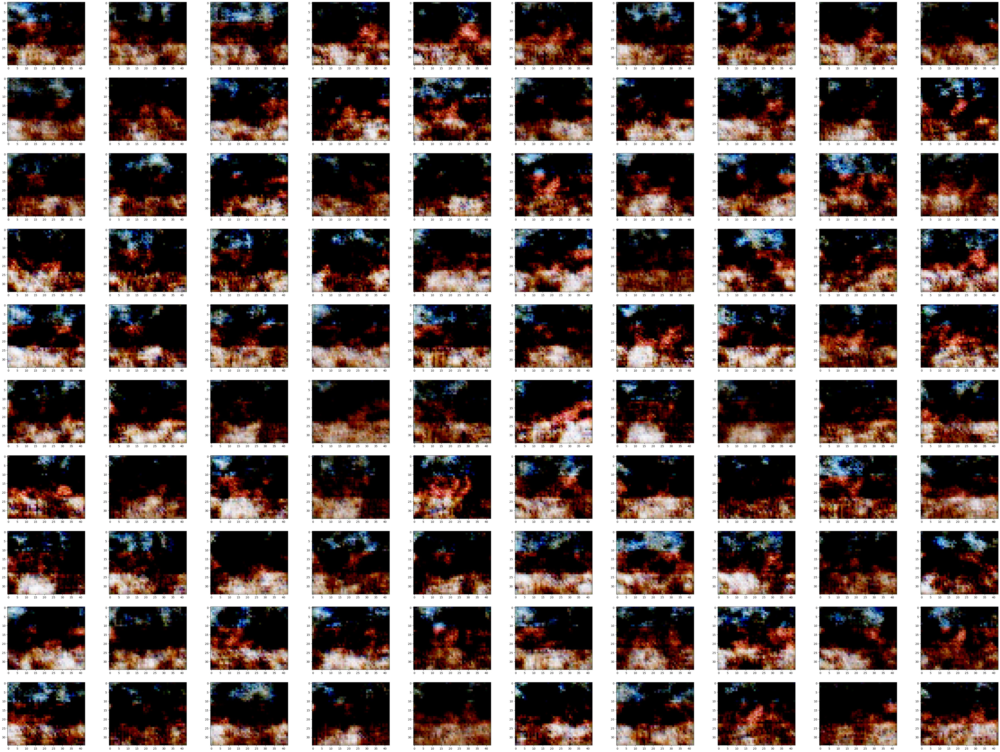

lol
Time elapsed: 36.91 min
Epoch: 002/030 | Batch 000/1582 | Gen/Dis Loss: 0.7558/0.6076
Epoch: 002/030 | Batch 100/1582 | Gen/Dis Loss: 0.7721/0.6046
Epoch: 002/030 | Batch 200/1582 | Gen/Dis Loss: 0.7928/0.5977
Epoch: 002/030 | Batch 300/1582 | Gen/Dis Loss: 0.7995/0.5870
Epoch: 002/030 | Batch 400/1582 | Gen/Dis Loss: 0.8111/0.5805
Epoch: 002/030 | Batch 500/1582 | Gen/Dis Loss: 0.8143/0.5819
Epoch: 002/030 | Batch 600/1582 | Gen/Dis Loss: 0.8335/0.5778
Epoch: 002/030 | Batch 700/1582 | Gen/Dis Loss: 0.7830/0.6026
Epoch: 002/030 | Batch 800/1582 | Gen/Dis Loss: 0.8130/0.5767
Epoch: 002/030 | Batch 900/1582 | Gen/Dis Loss: 0.8229/0.5861
Epoch: 002/030 | Batch 1000/1582 | Gen/Dis Loss: 0.8202/0.5945
Epoch: 002/030 | Batch 1100/1582 | Gen/Dis Loss: 0.8363/0.5622
Epoch: 002/030 | Batch 1200/1582 | Gen/Dis Loss: 0.8634/0.5537
Epoch: 002/030 | Batch 1300/1582 | Gen/Dis Loss: 0.8416/0.5756
Epoch: 002/030 | Batch 1400/1582 | Gen/Dis Loss: 0.8276/0.5719
Epoch: 002/030 | Batch 1500/1582 | Ge

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

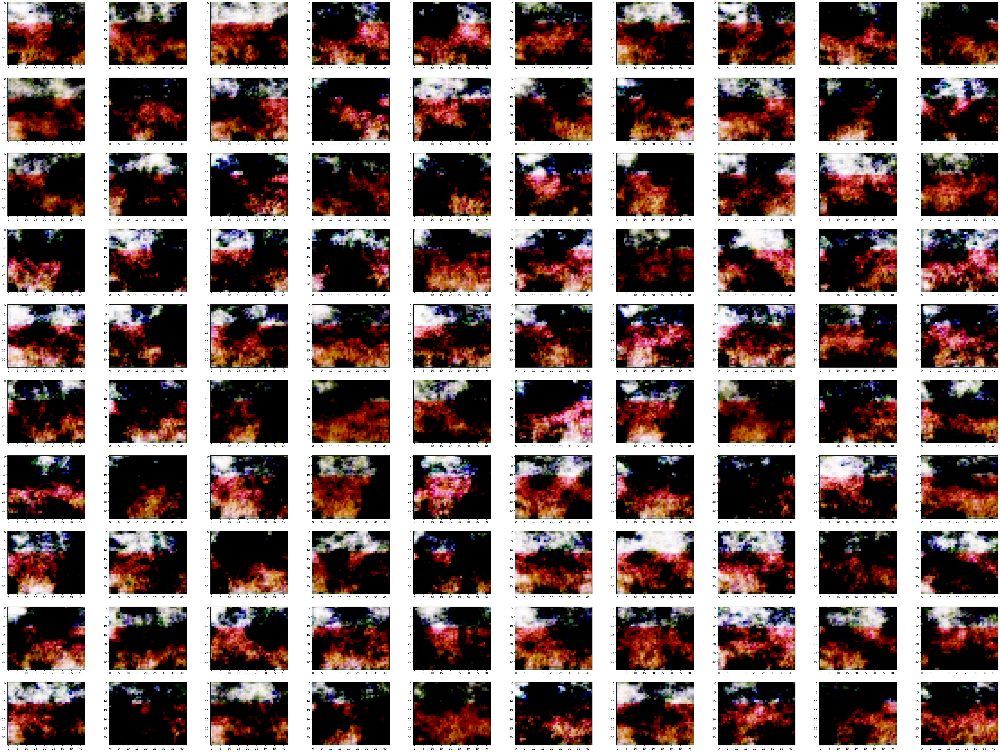

lol
Time elapsed: 74.73 min
Epoch: 003/030 | Batch 000/1582 | Gen/Dis Loss: 0.7794/0.5676
Epoch: 003/030 | Batch 100/1582 | Gen/Dis Loss: 0.8707/0.5610
Epoch: 003/030 | Batch 200/1582 | Gen/Dis Loss: 0.8280/0.5583
Epoch: 003/030 | Batch 300/1582 | Gen/Dis Loss: 0.8333/0.5510
Epoch: 003/030 | Batch 400/1582 | Gen/Dis Loss: 0.8450/0.5748
Epoch: 003/030 | Batch 500/1582 | Gen/Dis Loss: 0.8543/0.5576
Epoch: 003/030 | Batch 600/1582 | Gen/Dis Loss: 0.8084/0.5858
Epoch: 003/030 | Batch 700/1582 | Gen/Dis Loss: 0.8169/0.6096
Epoch: 003/030 | Batch 800/1582 | Gen/Dis Loss: 0.7545/0.5912
Epoch: 003/030 | Batch 900/1582 | Gen/Dis Loss: 0.8853/0.5736
Epoch: 003/030 | Batch 1000/1582 | Gen/Dis Loss: 0.8108/0.6116
Epoch: 003/030 | Batch 1100/1582 | Gen/Dis Loss: 0.8536/0.5649
Epoch: 003/030 | Batch 1200/1582 | Gen/Dis Loss: 0.8312/0.5485
Epoch: 003/030 | Batch 1300/1582 | Gen/Dis Loss: 0.8224/0.5826
Epoch: 003/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7683/0.5853
Epoch: 003/030 | Batch 1500/1582 | Ge

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

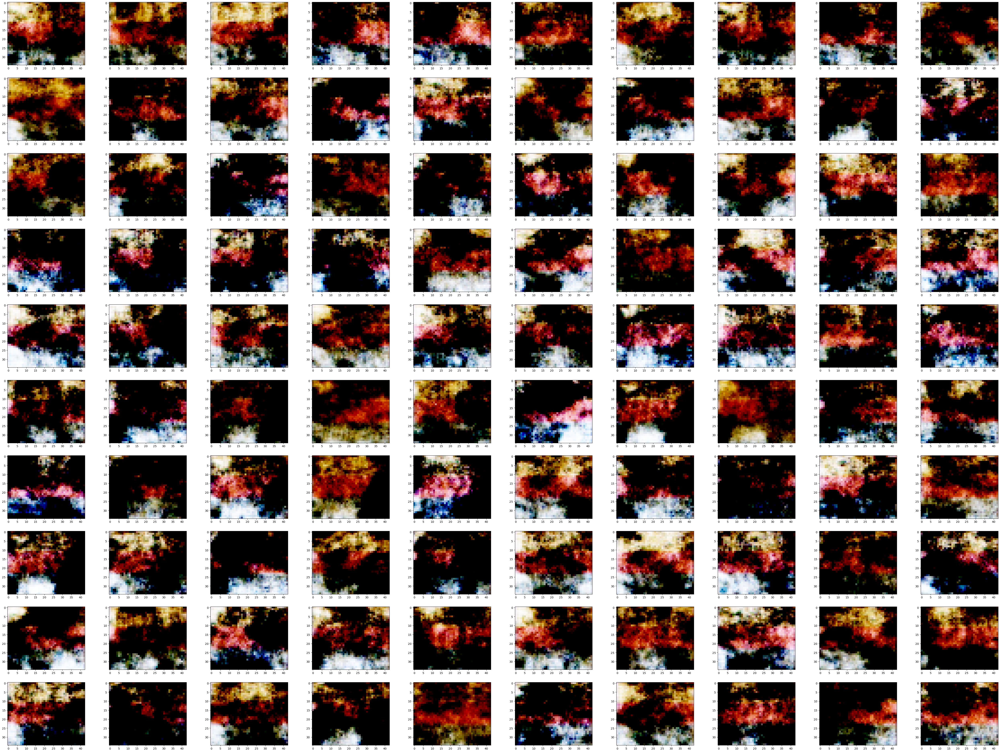

lol
Time elapsed: 112.76 min
Epoch: 004/030 | Batch 000/1582 | Gen/Dis Loss: 0.9531/0.5822
Epoch: 004/030 | Batch 100/1582 | Gen/Dis Loss: 0.8955/0.5633
Epoch: 004/030 | Batch 200/1582 | Gen/Dis Loss: 0.7427/0.5972
Epoch: 004/030 | Batch 300/1582 | Gen/Dis Loss: 0.8578/0.5725
Epoch: 004/030 | Batch 400/1582 | Gen/Dis Loss: 0.8928/0.5627
Epoch: 004/030 | Batch 500/1582 | Gen/Dis Loss: 0.8560/0.5660
Epoch: 004/030 | Batch 600/1582 | Gen/Dis Loss: 0.9179/0.5696
Epoch: 004/030 | Batch 700/1582 | Gen/Dis Loss: 0.8341/0.5971
Epoch: 004/030 | Batch 800/1582 | Gen/Dis Loss: 0.8018/0.5746
Epoch: 004/030 | Batch 900/1582 | Gen/Dis Loss: 0.9163/0.5719
Epoch: 004/030 | Batch 1000/1582 | Gen/Dis Loss: 0.8479/0.5951
Epoch: 004/030 | Batch 1100/1582 | Gen/Dis Loss: 0.8301/0.5621
Epoch: 004/030 | Batch 1200/1582 | Gen/Dis Loss: 0.8777/0.5425
Epoch: 004/030 | Batch 1300/1582 | Gen/Dis Loss: 0.8635/0.5589
Epoch: 004/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7769/0.5514
Epoch: 004/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

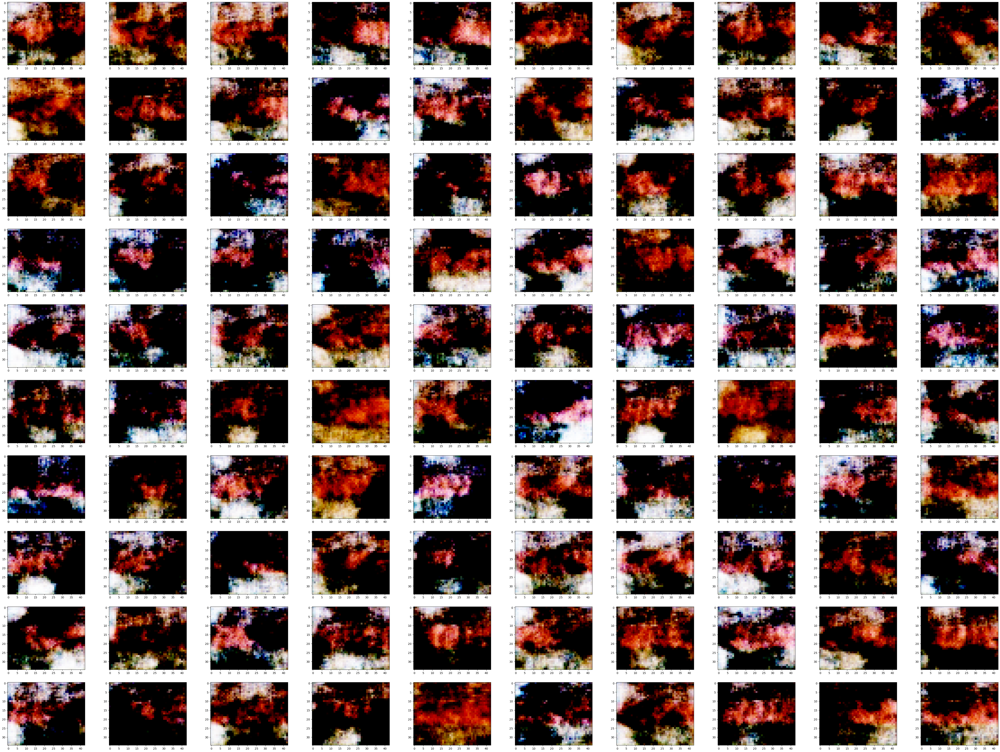

lol
Time elapsed: 150.82 min
Epoch: 005/030 | Batch 000/1582 | Gen/Dis Loss: 1.0438/0.5550
Epoch: 005/030 | Batch 100/1582 | Gen/Dis Loss: 0.9377/0.5394
Epoch: 005/030 | Batch 200/1582 | Gen/Dis Loss: 0.7261/0.5845
Epoch: 005/030 | Batch 300/1582 | Gen/Dis Loss: 0.9221/0.5535
Epoch: 005/030 | Batch 400/1582 | Gen/Dis Loss: 0.9443/0.5449
Epoch: 005/030 | Batch 500/1582 | Gen/Dis Loss: 0.9184/0.5502
Epoch: 005/030 | Batch 600/1582 | Gen/Dis Loss: 0.8957/0.5470
Epoch: 005/030 | Batch 700/1582 | Gen/Dis Loss: 0.9448/0.5567
Epoch: 005/030 | Batch 800/1582 | Gen/Dis Loss: 0.8335/0.5602
Epoch: 005/030 | Batch 900/1582 | Gen/Dis Loss: 0.9547/0.5364
Epoch: 005/030 | Batch 1000/1582 | Gen/Dis Loss: 0.9392/0.5582
Epoch: 005/030 | Batch 1100/1582 | Gen/Dis Loss: 0.9326/0.5239
Epoch: 005/030 | Batch 1200/1582 | Gen/Dis Loss: 0.9224/0.5084
Epoch: 005/030 | Batch 1300/1582 | Gen/Dis Loss: 0.9397/0.5214
Epoch: 005/030 | Batch 1400/1582 | Gen/Dis Loss: 0.8308/0.5234
Epoch: 005/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

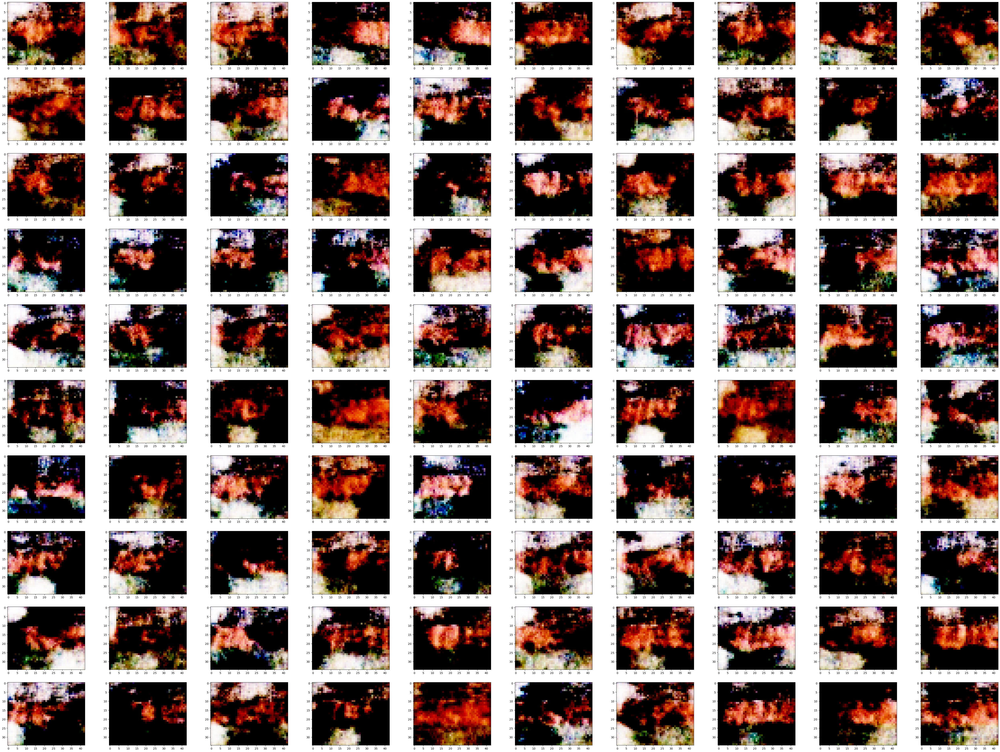

lol
Time elapsed: 189.07 min
Epoch: 006/030 | Batch 000/1582 | Gen/Dis Loss: 1.0472/0.5241
Epoch: 006/030 | Batch 100/1582 | Gen/Dis Loss: 0.9830/0.5001
Epoch: 006/030 | Batch 200/1582 | Gen/Dis Loss: 0.7810/0.5243
Epoch: 006/030 | Batch 300/1582 | Gen/Dis Loss: 0.9733/0.5050
Epoch: 006/030 | Batch 400/1582 | Gen/Dis Loss: 1.0578/0.5010
Epoch: 006/030 | Batch 500/1582 | Gen/Dis Loss: 0.9482/0.5183
Epoch: 006/030 | Batch 600/1582 | Gen/Dis Loss: 0.9074/0.5627
Epoch: 006/030 | Batch 700/1582 | Gen/Dis Loss: 0.9953/0.5405
Epoch: 006/030 | Batch 800/1582 | Gen/Dis Loss: 0.8783/0.5316
Epoch: 006/030 | Batch 900/1582 | Gen/Dis Loss: 0.9469/0.5170
Epoch: 006/030 | Batch 1000/1582 | Gen/Dis Loss: 0.9521/0.5170
Epoch: 006/030 | Batch 1100/1582 | Gen/Dis Loss: 0.9701/0.5125
Epoch: 006/030 | Batch 1200/1582 | Gen/Dis Loss: 0.8761/0.4756
Epoch: 006/030 | Batch 1300/1582 | Gen/Dis Loss: 0.9659/0.5370
Epoch: 006/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7582/0.5631
Epoch: 006/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

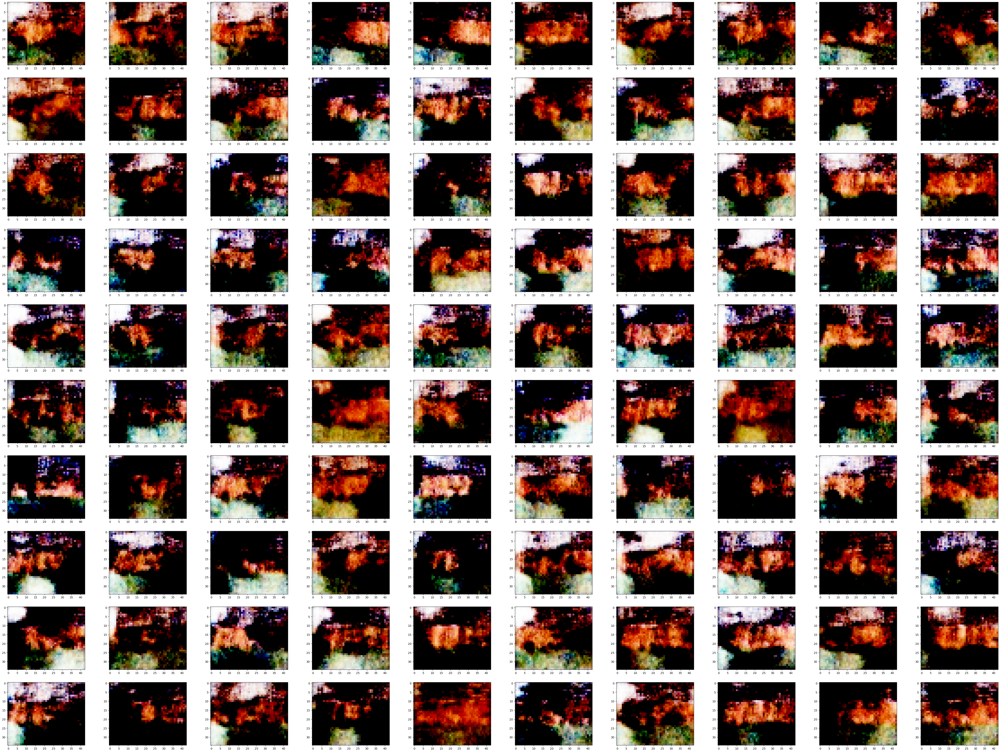

lol
Time elapsed: 227.15 min
Epoch: 007/030 | Batch 000/1582 | Gen/Dis Loss: 1.0441/0.4944
Epoch: 007/030 | Batch 100/1582 | Gen/Dis Loss: 1.1218/0.4653
Epoch: 007/030 | Batch 200/1582 | Gen/Dis Loss: 0.8791/0.4987
Epoch: 007/030 | Batch 300/1582 | Gen/Dis Loss: 1.0077/0.4873
Epoch: 007/030 | Batch 400/1582 | Gen/Dis Loss: 1.0407/0.4898
Epoch: 007/030 | Batch 500/1582 | Gen/Dis Loss: 0.9689/0.4848
Epoch: 007/030 | Batch 600/1582 | Gen/Dis Loss: 1.0393/0.5104
Epoch: 007/030 | Batch 700/1582 | Gen/Dis Loss: 1.0124/0.4972
Epoch: 007/030 | Batch 800/1582 | Gen/Dis Loss: 0.8574/0.5479
Epoch: 007/030 | Batch 900/1582 | Gen/Dis Loss: 1.0110/0.5022
Epoch: 007/030 | Batch 1000/1582 | Gen/Dis Loss: 1.0033/0.4943
Epoch: 007/030 | Batch 1100/1582 | Gen/Dis Loss: 1.0331/0.4713
Epoch: 007/030 | Batch 1200/1582 | Gen/Dis Loss: 0.8832/0.4663
Epoch: 007/030 | Batch 1300/1582 | Gen/Dis Loss: 0.9583/0.4952
Epoch: 007/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7567/0.5013
Epoch: 007/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

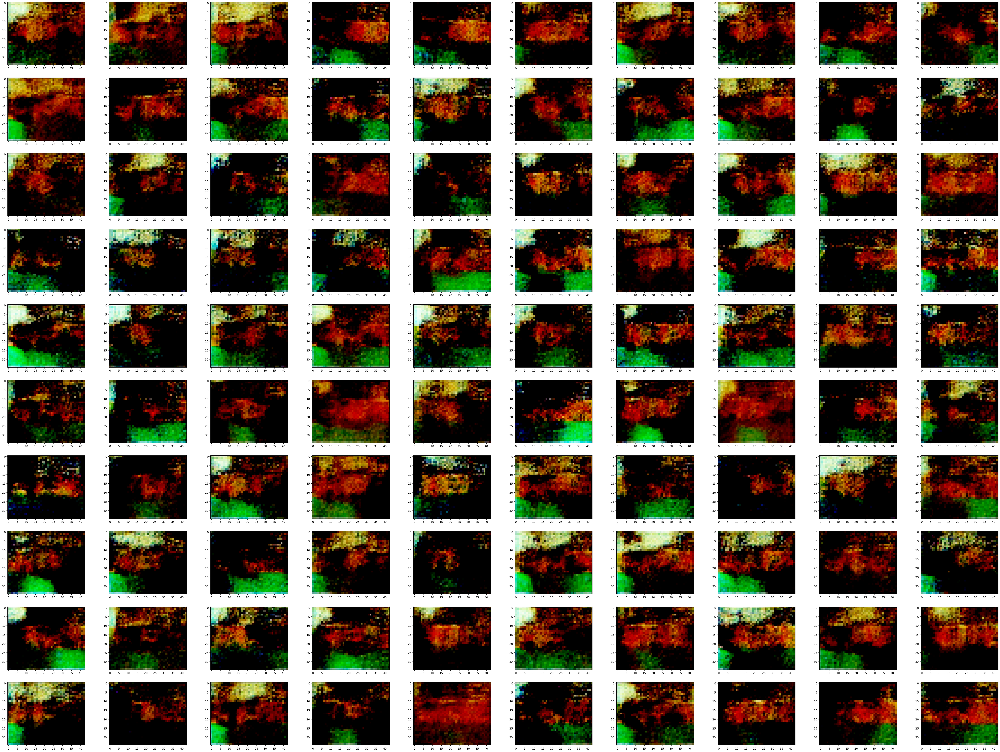

lol
Time elapsed: 265.34 min
Epoch: 008/030 | Batch 000/1582 | Gen/Dis Loss: 1.0805/0.3518
Epoch: 008/030 | Batch 100/1582 | Gen/Dis Loss: 0.9534/0.2836
Epoch: 008/030 | Batch 200/1582 | Gen/Dis Loss: 0.9788/0.2721
Epoch: 008/030 | Batch 300/1582 | Gen/Dis Loss: 1.0078/0.2568
Epoch: 008/030 | Batch 400/1582 | Gen/Dis Loss: 1.0848/0.2403
Epoch: 008/030 | Batch 500/1582 | Gen/Dis Loss: 1.1739/0.2158
Epoch: 008/030 | Batch 600/1582 | Gen/Dis Loss: 1.2272/0.2048
Epoch: 008/030 | Batch 700/1582 | Gen/Dis Loss: 1.2545/0.2013
Epoch: 008/030 | Batch 800/1582 | Gen/Dis Loss: 1.1715/0.2123
Epoch: 008/030 | Batch 900/1582 | Gen/Dis Loss: 0.8485/0.3206
Epoch: 008/030 | Batch 1000/1582 | Gen/Dis Loss: 0.7188/0.3810
Epoch: 008/030 | Batch 1100/1582 | Gen/Dis Loss: 0.7951/0.3398
Epoch: 008/030 | Batch 1200/1582 | Gen/Dis Loss: 0.8975/0.2961
Epoch: 008/030 | Batch 1300/1582 | Gen/Dis Loss: 1.0247/0.2577
Epoch: 008/030 | Batch 1400/1582 | Gen/Dis Loss: 1.1247/0.2308
Epoch: 008/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

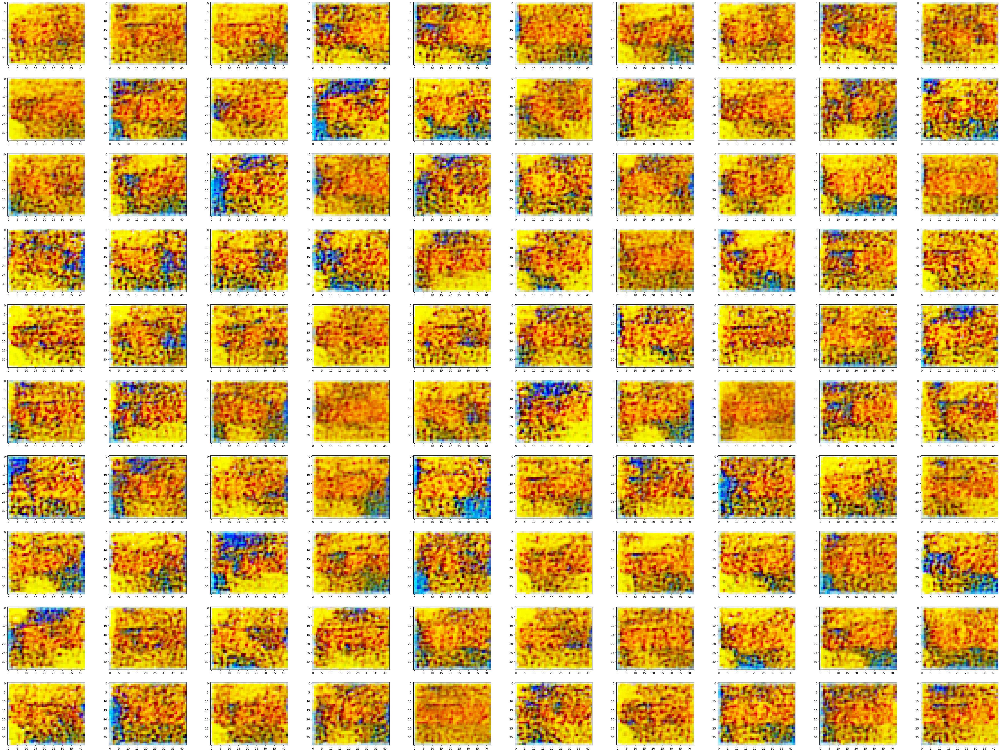

lol
Time elapsed: 303.39 min
Epoch: 009/030 | Batch 000/1582 | Gen/Dis Loss: 1.3502/0.1840
Epoch: 009/030 | Batch 100/1582 | Gen/Dis Loss: 1.5137/0.1576
Epoch: 009/030 | Batch 200/1582 | Gen/Dis Loss: 1.5952/0.1448
Epoch: 009/030 | Batch 300/1582 | Gen/Dis Loss: 1.6485/0.1355
Epoch: 009/030 | Batch 400/1582 | Gen/Dis Loss: 1.4332/0.1743
Epoch: 009/030 | Batch 500/1582 | Gen/Dis Loss: 1.3612/0.1815
Epoch: 009/030 | Batch 600/1582 | Gen/Dis Loss: 1.5029/0.1598
Epoch: 009/030 | Batch 700/1582 | Gen/Dis Loss: 0.9706/0.5072
Epoch: 009/030 | Batch 800/1582 | Gen/Dis Loss: 1.0787/0.4750
Epoch: 009/030 | Batch 900/1582 | Gen/Dis Loss: 0.9863/0.5145
Epoch: 009/030 | Batch 1000/1582 | Gen/Dis Loss: 0.9050/0.5710
Epoch: 009/030 | Batch 1100/1582 | Gen/Dis Loss: 1.0415/0.4828
Epoch: 009/030 | Batch 1200/1582 | Gen/Dis Loss: 1.1273/0.4407
Epoch: 009/030 | Batch 1300/1582 | Gen/Dis Loss: 1.0738/0.4566
Epoch: 009/030 | Batch 1400/1582 | Gen/Dis Loss: 0.9068/0.4687
Epoch: 009/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

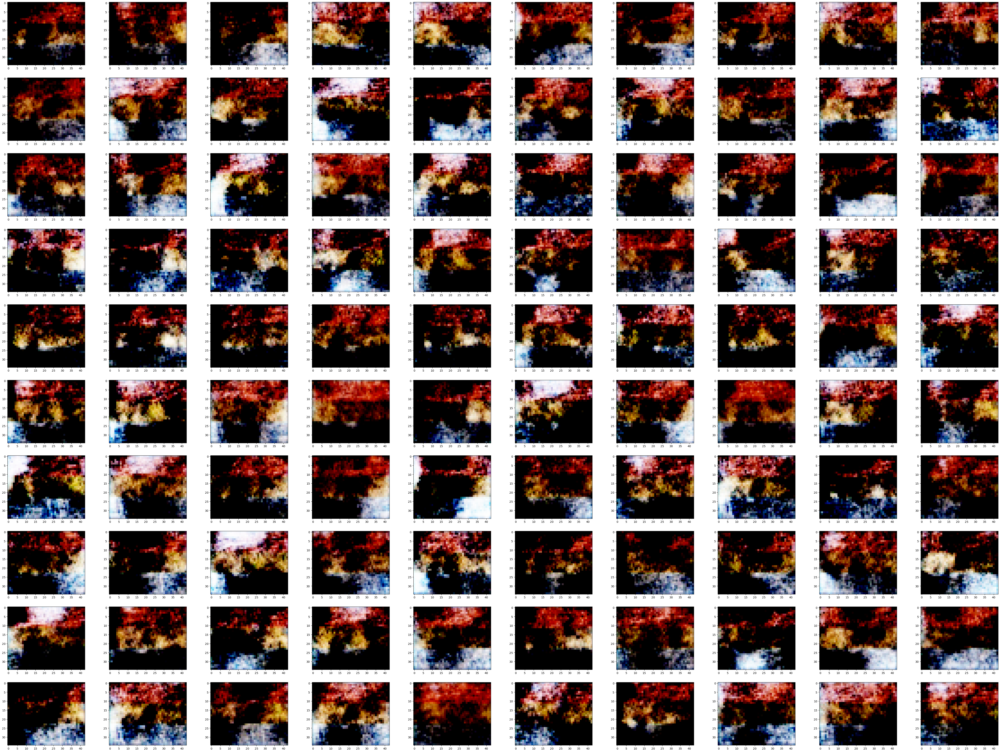

lol
Time elapsed: 341.46 min
Epoch: 010/030 | Batch 000/1582 | Gen/Dis Loss: 1.2498/0.4472
Epoch: 010/030 | Batch 100/1582 | Gen/Dis Loss: 1.1603/0.4259
Epoch: 010/030 | Batch 200/1582 | Gen/Dis Loss: 0.8791/0.4600
Epoch: 010/030 | Batch 300/1582 | Gen/Dis Loss: 1.1829/0.4115
Epoch: 010/030 | Batch 400/1582 | Gen/Dis Loss: 1.1061/0.4499
Epoch: 010/030 | Batch 500/1582 | Gen/Dis Loss: 1.1074/0.4303
Epoch: 010/030 | Batch 600/1582 | Gen/Dis Loss: 1.1079/0.4488
Epoch: 010/030 | Batch 700/1582 | Gen/Dis Loss: 0.9757/0.4685
Epoch: 010/030 | Batch 800/1582 | Gen/Dis Loss: 1.0497/0.4625
Epoch: 010/030 | Batch 900/1582 | Gen/Dis Loss: 1.0868/0.4370
Epoch: 010/030 | Batch 1000/1582 | Gen/Dis Loss: 0.9241/0.4797
Epoch: 010/030 | Batch 1100/1582 | Gen/Dis Loss: 1.0889/0.4159
Epoch: 010/030 | Batch 1200/1582 | Gen/Dis Loss: 1.1401/0.3909
Epoch: 010/030 | Batch 1300/1582 | Gen/Dis Loss: 0.9652/0.4710
Epoch: 010/030 | Batch 1400/1582 | Gen/Dis Loss: 0.8900/0.4401
Epoch: 010/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

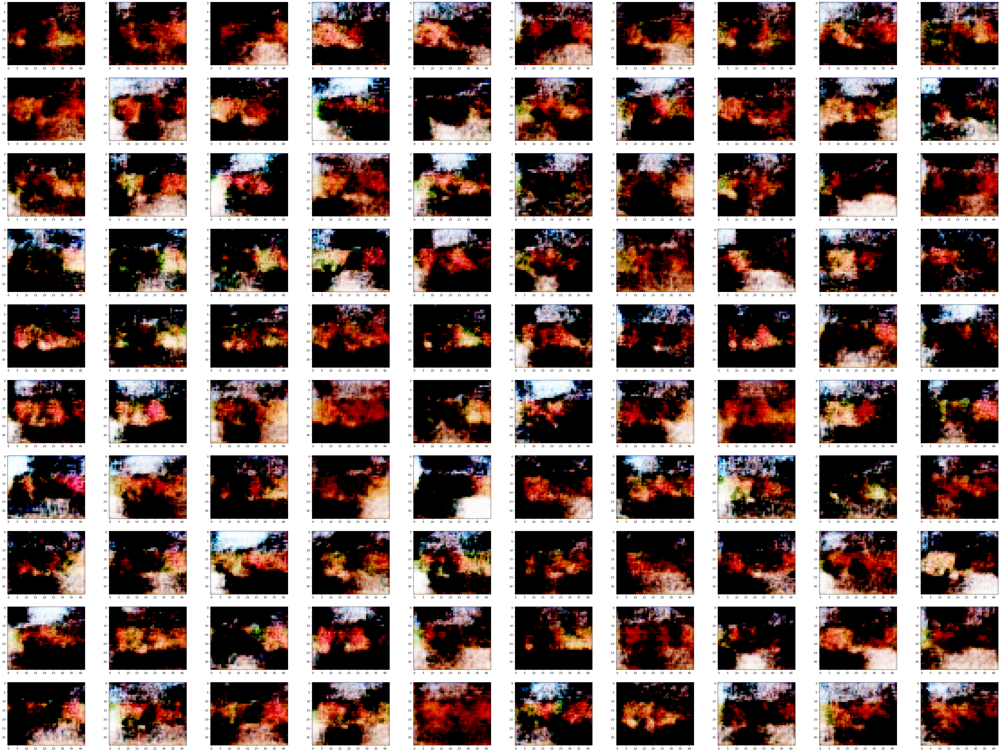

lol
Time elapsed: 379.69 min
Epoch: 011/030 | Batch 000/1582 | Gen/Dis Loss: 1.6576/0.4618
Epoch: 011/030 | Batch 100/1582 | Gen/Dis Loss: 1.1509/0.4253
Epoch: 011/030 | Batch 200/1582 | Gen/Dis Loss: 0.7479/0.4929
Epoch: 011/030 | Batch 300/1582 | Gen/Dis Loss: 1.1724/0.4419
Epoch: 011/030 | Batch 400/1582 | Gen/Dis Loss: 1.1063/0.4519
Epoch: 011/030 | Batch 500/1582 | Gen/Dis Loss: 1.0972/0.4644
Epoch: 011/030 | Batch 600/1582 | Gen/Dis Loss: 0.9684/0.5077
Epoch: 011/030 | Batch 700/1582 | Gen/Dis Loss: 1.0021/0.5206
Epoch: 011/030 | Batch 800/1582 | Gen/Dis Loss: 0.9410/0.4985
Epoch: 011/030 | Batch 900/1582 | Gen/Dis Loss: 1.0809/0.4631
Epoch: 011/030 | Batch 1000/1582 | Gen/Dis Loss: 1.3490/0.3529
Epoch: 011/030 | Batch 1100/1582 | Gen/Dis Loss: 1.5674/0.1975
Epoch: 011/030 | Batch 1200/1582 | Gen/Dis Loss: 1.1093/0.4428
Epoch: 011/030 | Batch 1300/1582 | Gen/Dis Loss: 0.8975/0.5621
Epoch: 011/030 | Batch 1400/1582 | Gen/Dis Loss: 0.8033/0.5386
Epoch: 011/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

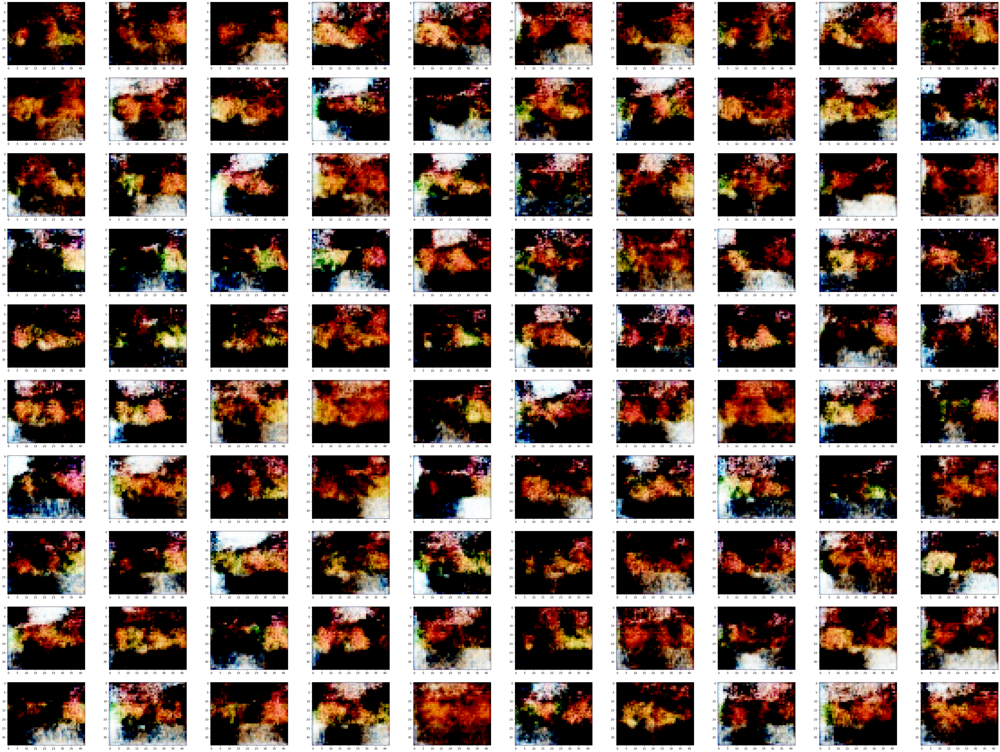

lol
Time elapsed: 417.74 min
Epoch: 012/030 | Batch 000/1582 | Gen/Dis Loss: 1.2480/0.5039
Epoch: 012/030 | Batch 100/1582 | Gen/Dis Loss: 1.0169/0.4886
Epoch: 012/030 | Batch 200/1582 | Gen/Dis Loss: 0.6421/0.5312
Epoch: 012/030 | Batch 300/1582 | Gen/Dis Loss: 1.0766/0.4966
Epoch: 012/030 | Batch 400/1582 | Gen/Dis Loss: 0.9304/0.5168
Epoch: 012/030 | Batch 500/1582 | Gen/Dis Loss: 1.0631/0.5002
Epoch: 012/030 | Batch 600/1582 | Gen/Dis Loss: 0.9745/0.5054
Epoch: 012/030 | Batch 700/1582 | Gen/Dis Loss: 0.9355/0.5451
Epoch: 012/030 | Batch 800/1582 | Gen/Dis Loss: 0.8241/0.5365
Epoch: 012/030 | Batch 900/1582 | Gen/Dis Loss: 0.9549/0.5156
Epoch: 012/030 | Batch 1000/1582 | Gen/Dis Loss: 0.9706/0.5224
Epoch: 012/030 | Batch 1100/1582 | Gen/Dis Loss: 1.0280/0.4945
Epoch: 012/030 | Batch 1200/1582 | Gen/Dis Loss: 0.8562/0.4828
Epoch: 012/030 | Batch 1300/1582 | Gen/Dis Loss: 0.9579/0.5128
Epoch: 012/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7416/0.5177
Epoch: 012/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

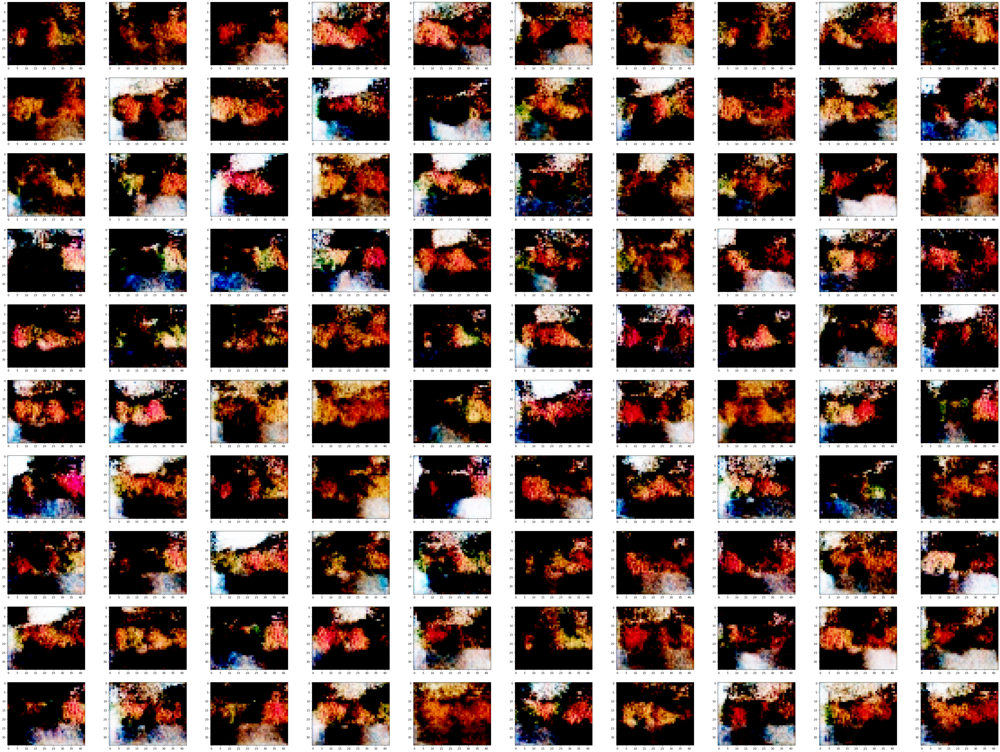

lol
Time elapsed: 456.02 min
Epoch: 013/030 | Batch 000/1582 | Gen/Dis Loss: 1.0321/0.5029
Epoch: 013/030 | Batch 100/1582 | Gen/Dis Loss: 0.9357/0.5124
Epoch: 013/030 | Batch 200/1582 | Gen/Dis Loss: 0.6545/0.5446
Epoch: 013/030 | Batch 300/1582 | Gen/Dis Loss: 1.0482/0.5379
Epoch: 013/030 | Batch 400/1582 | Gen/Dis Loss: 0.9693/0.5195
Epoch: 013/030 | Batch 500/1582 | Gen/Dis Loss: 1.0084/0.5249
Epoch: 013/030 | Batch 600/1582 | Gen/Dis Loss: 0.9805/0.5272
Epoch: 013/030 | Batch 700/1582 | Gen/Dis Loss: 0.8776/0.5326
Epoch: 013/030 | Batch 800/1582 | Gen/Dis Loss: 0.7338/0.5439
Epoch: 013/030 | Batch 900/1582 | Gen/Dis Loss: 0.9312/0.5331
Epoch: 013/030 | Batch 1000/1582 | Gen/Dis Loss: 1.0490/0.5455
Epoch: 013/030 | Batch 1100/1582 | Gen/Dis Loss: 1.0062/0.5105
Epoch: 013/030 | Batch 1200/1582 | Gen/Dis Loss: 0.8634/0.5093
Epoch: 013/030 | Batch 1300/1582 | Gen/Dis Loss: 0.9964/0.5333
Epoch: 013/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7126/0.5283
Epoch: 013/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

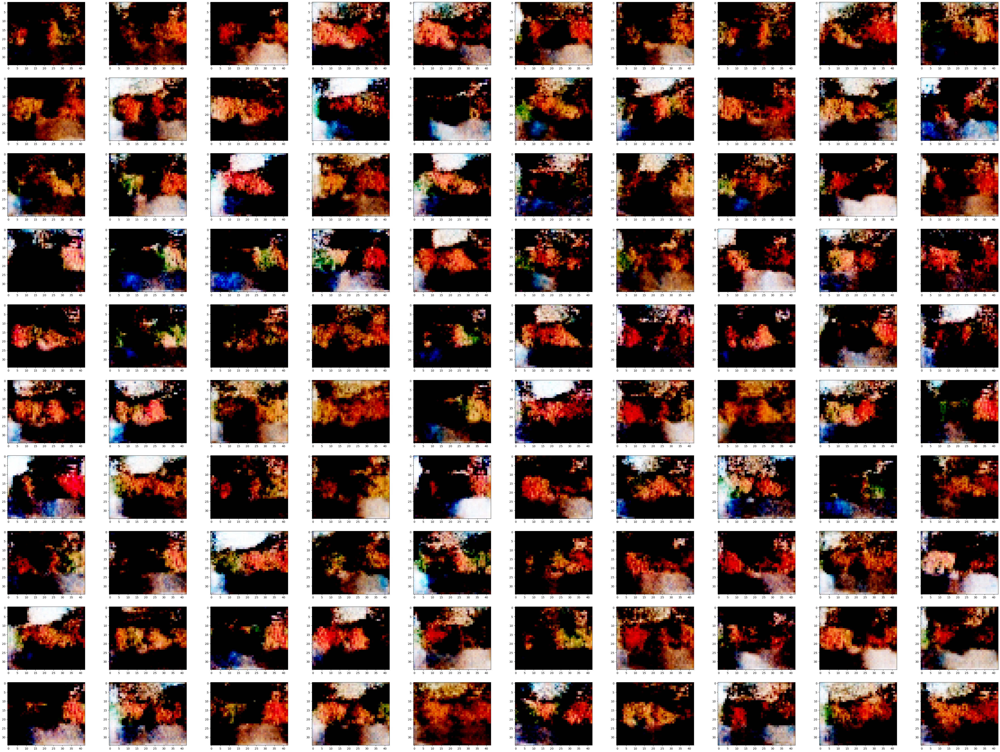

lol
Time elapsed: 494.12 min
Epoch: 014/030 | Batch 000/1582 | Gen/Dis Loss: 0.6690/0.5131
Epoch: 014/030 | Batch 100/1582 | Gen/Dis Loss: 0.9346/0.5339
Epoch: 014/030 | Batch 200/1582 | Gen/Dis Loss: 0.6229/0.5386
Epoch: 014/030 | Batch 300/1582 | Gen/Dis Loss: 1.0350/0.5384
Epoch: 014/030 | Batch 400/1582 | Gen/Dis Loss: 0.9412/0.5177
Epoch: 014/030 | Batch 500/1582 | Gen/Dis Loss: 0.8156/0.5469
Epoch: 014/030 | Batch 600/1582 | Gen/Dis Loss: 1.0021/0.5347
Epoch: 014/030 | Batch 700/1582 | Gen/Dis Loss: 0.9448/0.5436
Epoch: 014/030 | Batch 800/1582 | Gen/Dis Loss: 0.8593/0.5517
Epoch: 014/030 | Batch 900/1582 | Gen/Dis Loss: 0.8793/0.5404
Epoch: 014/030 | Batch 1000/1582 | Gen/Dis Loss: 0.9969/0.5245
Epoch: 014/030 | Batch 1100/1582 | Gen/Dis Loss: 0.9515/0.5340
Epoch: 014/030 | Batch 1200/1582 | Gen/Dis Loss: 0.8106/0.5125
Epoch: 014/030 | Batch 1300/1582 | Gen/Dis Loss: 1.0421/0.5360
Epoch: 014/030 | Batch 1400/1582 | Gen/Dis Loss: 0.8133/0.5192
Epoch: 014/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

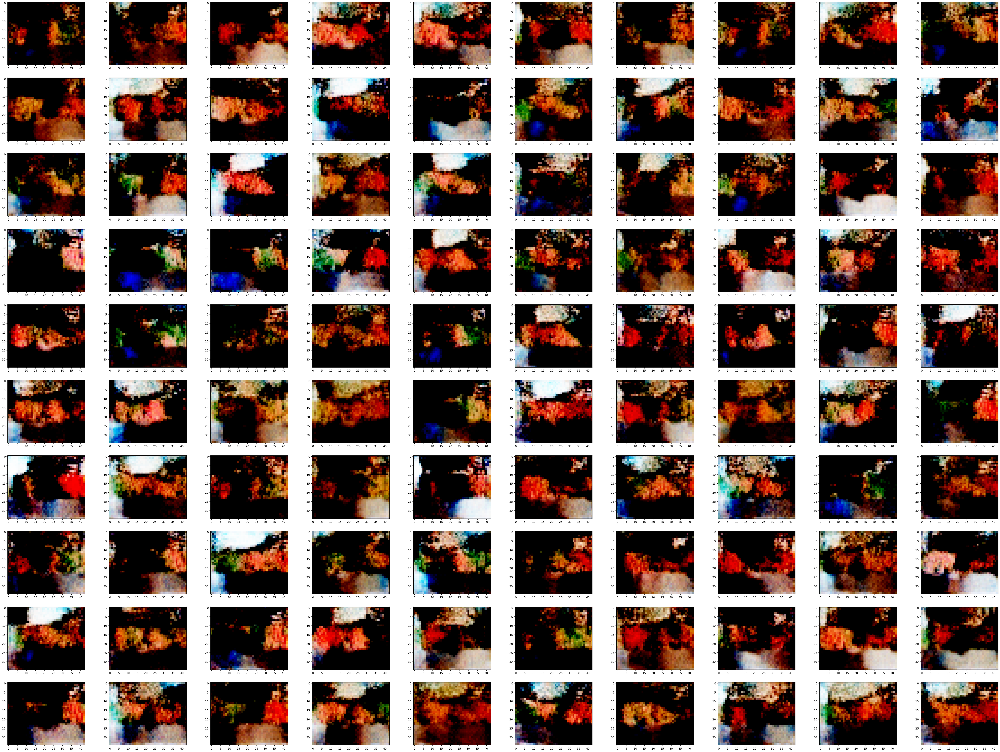

lol
Time elapsed: 532.28 min
Epoch: 015/030 | Batch 000/1582 | Gen/Dis Loss: 1.5737/0.4990
Epoch: 015/030 | Batch 100/1582 | Gen/Dis Loss: 1.0090/0.5239
Epoch: 015/030 | Batch 200/1582 | Gen/Dis Loss: 0.7191/0.5403
Epoch: 015/030 | Batch 300/1582 | Gen/Dis Loss: 0.9250/0.5474
Epoch: 015/030 | Batch 400/1582 | Gen/Dis Loss: 0.9164/0.5378
Epoch: 015/030 | Batch 500/1582 | Gen/Dis Loss: 0.7993/0.5420
Epoch: 015/030 | Batch 600/1582 | Gen/Dis Loss: 0.9492/0.5507
Epoch: 015/030 | Batch 700/1582 | Gen/Dis Loss: 0.9333/0.5407
Epoch: 015/030 | Batch 800/1582 | Gen/Dis Loss: 0.9044/0.5332
Epoch: 015/030 | Batch 900/1582 | Gen/Dis Loss: 1.0505/0.5538
Epoch: 015/030 | Batch 1000/1582 | Gen/Dis Loss: 0.8813/0.5478
Epoch: 015/030 | Batch 1100/1582 | Gen/Dis Loss: 1.0102/0.5273
Epoch: 015/030 | Batch 1200/1582 | Gen/Dis Loss: 0.6973/0.5626
Epoch: 015/030 | Batch 1300/1582 | Gen/Dis Loss: 0.8626/0.5627
Epoch: 015/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7260/0.5461
Epoch: 015/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

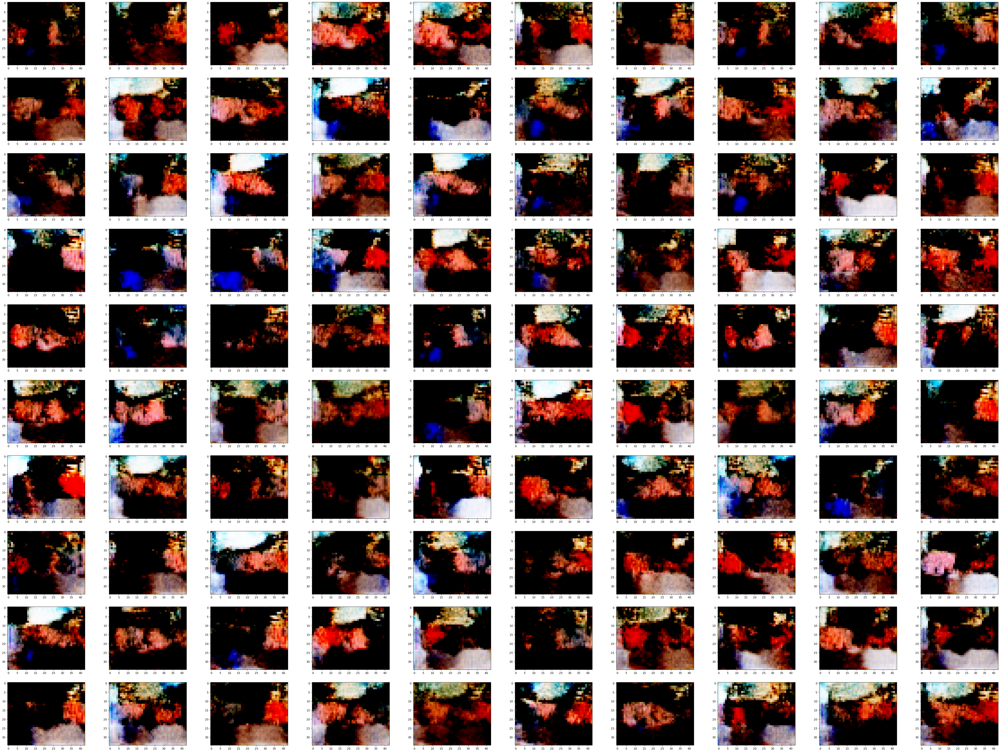

lol
Time elapsed: 570.18 min
Epoch: 016/030 | Batch 000/1582 | Gen/Dis Loss: 0.6920/0.5273
Epoch: 016/030 | Batch 100/1582 | Gen/Dis Loss: 0.9230/0.5286
Epoch: 016/030 | Batch 200/1582 | Gen/Dis Loss: 0.6972/0.5373
Epoch: 016/030 | Batch 300/1582 | Gen/Dis Loss: 0.8649/0.5577
Epoch: 016/030 | Batch 400/1582 | Gen/Dis Loss: 0.8073/0.5765
Epoch: 016/030 | Batch 500/1582 | Gen/Dis Loss: 0.8106/0.6002
Epoch: 016/030 | Batch 600/1582 | Gen/Dis Loss: 0.9701/0.5938
Epoch: 016/030 | Batch 700/1582 | Gen/Dis Loss: 0.8359/0.5726
Epoch: 016/030 | Batch 800/1582 | Gen/Dis Loss: 0.8249/0.5879
Epoch: 016/030 | Batch 900/1582 | Gen/Dis Loss: 0.7662/0.6225
Epoch: 016/030 | Batch 1000/1582 | Gen/Dis Loss: 0.9097/0.5470
Epoch: 016/030 | Batch 1100/1582 | Gen/Dis Loss: 1.0062/0.5150
Epoch: 016/030 | Batch 1200/1582 | Gen/Dis Loss: 0.8288/0.5378
Epoch: 016/030 | Batch 1300/1582 | Gen/Dis Loss: 0.9905/0.5721
Epoch: 016/030 | Batch 1400/1582 | Gen/Dis Loss: 0.8032/0.5875
Epoch: 016/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

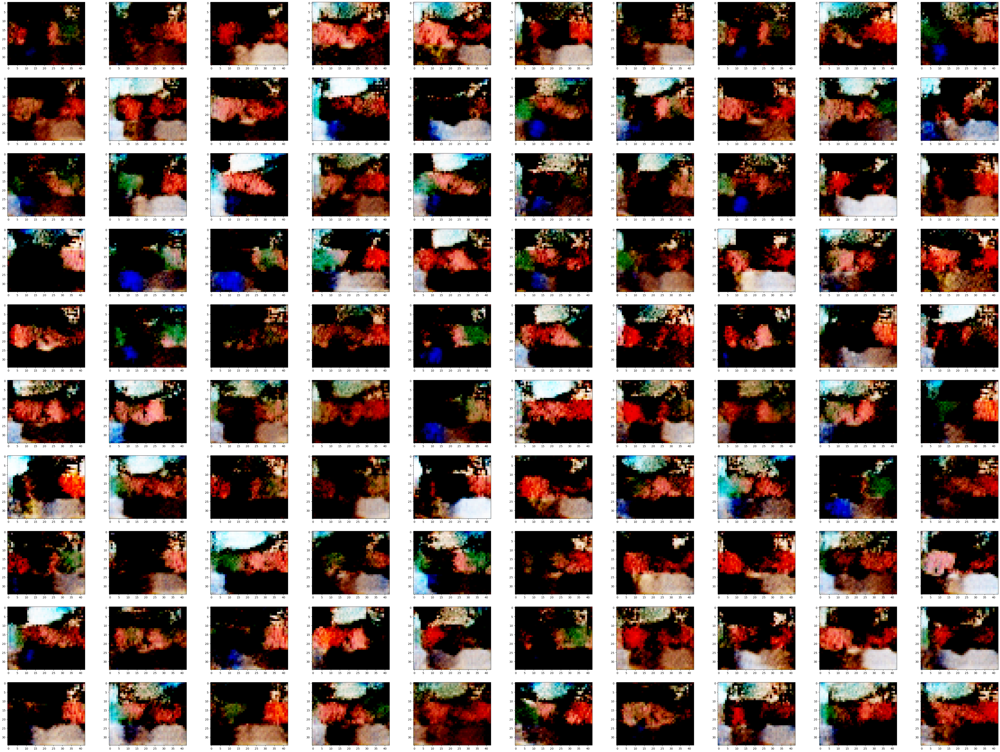

lol
Time elapsed: 608.21 min
Epoch: 017/030 | Batch 000/1582 | Gen/Dis Loss: 0.5467/0.6193
Epoch: 017/030 | Batch 100/1582 | Gen/Dis Loss: 0.8543/0.5624
Epoch: 017/030 | Batch 200/1582 | Gen/Dis Loss: 0.6896/0.5815
Epoch: 017/030 | Batch 300/1582 | Gen/Dis Loss: 0.8315/0.6113
Epoch: 017/030 | Batch 400/1582 | Gen/Dis Loss: 0.8036/0.5957
Epoch: 017/030 | Batch 500/1582 | Gen/Dis Loss: 1.0273/0.5961
Epoch: 017/030 | Batch 600/1582 | Gen/Dis Loss: 1.0508/0.5741
Epoch: 017/030 | Batch 700/1582 | Gen/Dis Loss: 0.8180/0.5936
Epoch: 017/030 | Batch 800/1582 | Gen/Dis Loss: 0.7637/0.5882
Epoch: 017/030 | Batch 900/1582 | Gen/Dis Loss: 0.9416/0.6129
Epoch: 017/030 | Batch 1000/1582 | Gen/Dis Loss: 0.8259/0.5886
Epoch: 017/030 | Batch 1100/1582 | Gen/Dis Loss: 0.7875/0.5847
Epoch: 017/030 | Batch 1200/1582 | Gen/Dis Loss: 0.7606/0.5634
Epoch: 017/030 | Batch 1300/1582 | Gen/Dis Loss: 0.8476/0.5786
Epoch: 017/030 | Batch 1400/1582 | Gen/Dis Loss: 0.6434/0.5935
Epoch: 017/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

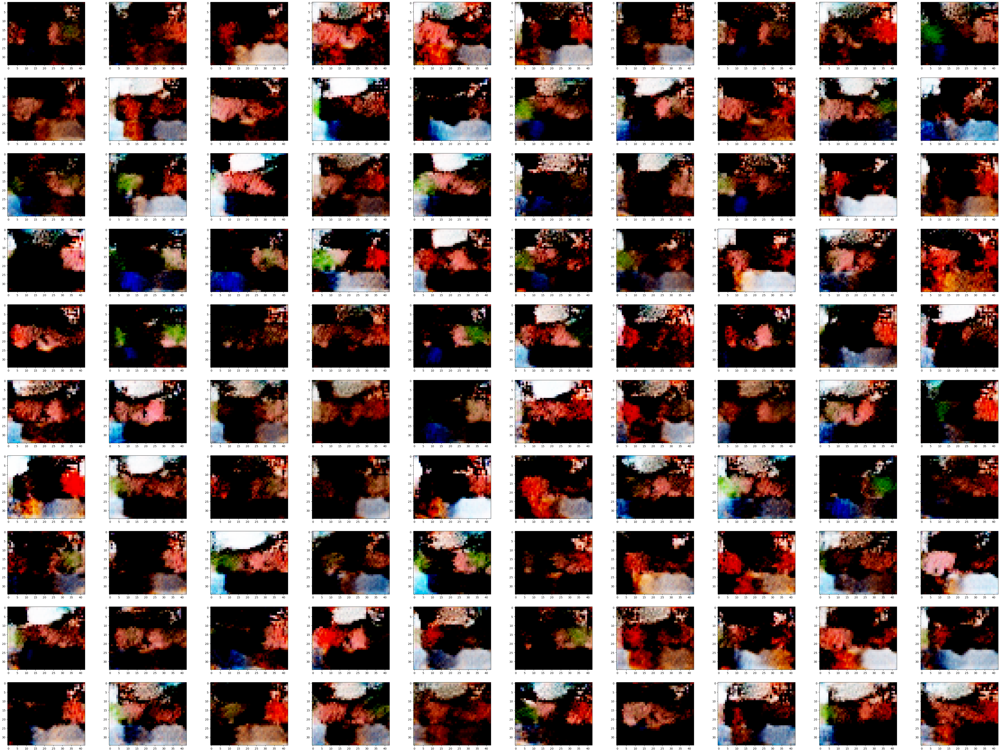

lol
Time elapsed: 646.36 min
Epoch: 018/030 | Batch 000/1582 | Gen/Dis Loss: 0.4743/0.5618
Epoch: 018/030 | Batch 100/1582 | Gen/Dis Loss: 0.8257/0.5703
Epoch: 018/030 | Batch 200/1582 | Gen/Dis Loss: 0.6981/0.6086
Epoch: 018/030 | Batch 300/1582 | Gen/Dis Loss: 0.8764/0.6275
Epoch: 018/030 | Batch 400/1582 | Gen/Dis Loss: 0.7247/0.5906
Epoch: 018/030 | Batch 500/1582 | Gen/Dis Loss: 0.7638/0.6079
Epoch: 018/030 | Batch 600/1582 | Gen/Dis Loss: 0.9752/0.6017
Epoch: 018/030 | Batch 700/1582 | Gen/Dis Loss: 0.7908/0.6141
Epoch: 018/030 | Batch 800/1582 | Gen/Dis Loss: 0.6665/0.6172
Epoch: 018/030 | Batch 900/1582 | Gen/Dis Loss: 0.8240/0.6011
Epoch: 018/030 | Batch 1000/1582 | Gen/Dis Loss: 0.8433/0.6061
Epoch: 018/030 | Batch 1100/1582 | Gen/Dis Loss: 0.8539/0.5901
Epoch: 018/030 | Batch 1200/1582 | Gen/Dis Loss: 0.6241/0.5989
Epoch: 018/030 | Batch 1300/1582 | Gen/Dis Loss: 0.8999/0.5937
Epoch: 018/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7220/0.5910
Epoch: 018/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

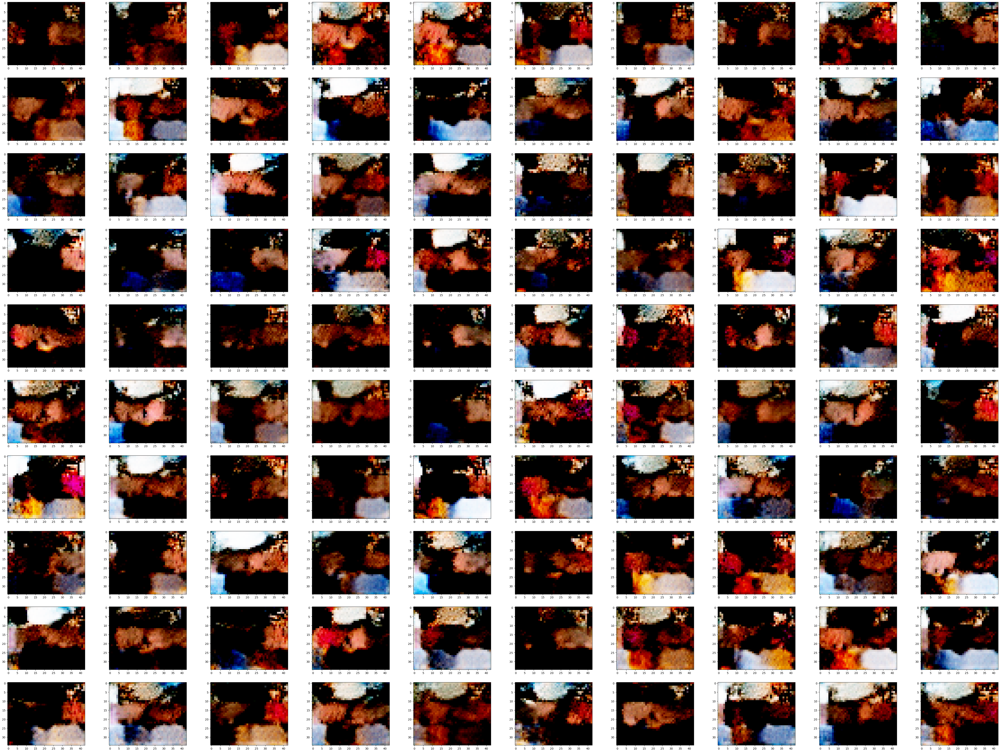

lol
Time elapsed: 684.33 min
Epoch: 019/030 | Batch 000/1582 | Gen/Dis Loss: 0.6448/0.5890
Epoch: 019/030 | Batch 100/1582 | Gen/Dis Loss: 0.7354/0.6047
Epoch: 019/030 | Batch 200/1582 | Gen/Dis Loss: 0.7327/0.6056
Epoch: 019/030 | Batch 300/1582 | Gen/Dis Loss: 0.8892/0.6029
Epoch: 019/030 | Batch 400/1582 | Gen/Dis Loss: 0.7825/0.5966
Epoch: 019/030 | Batch 500/1582 | Gen/Dis Loss: 0.8117/0.5998
Epoch: 019/030 | Batch 600/1582 | Gen/Dis Loss: 0.8971/0.5917
Epoch: 019/030 | Batch 700/1582 | Gen/Dis Loss: 0.8727/0.5832
Epoch: 019/030 | Batch 800/1582 | Gen/Dis Loss: 0.7108/0.6092
Epoch: 019/030 | Batch 900/1582 | Gen/Dis Loss: 0.8995/0.6147
Epoch: 019/030 | Batch 1000/1582 | Gen/Dis Loss: 0.8440/0.6204
Epoch: 019/030 | Batch 1100/1582 | Gen/Dis Loss: 0.8217/0.5857
Epoch: 019/030 | Batch 1200/1582 | Gen/Dis Loss: 0.6874/0.5923
Epoch: 019/030 | Batch 1300/1582 | Gen/Dis Loss: 0.8362/0.5987
Epoch: 019/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7330/0.5908
Epoch: 019/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

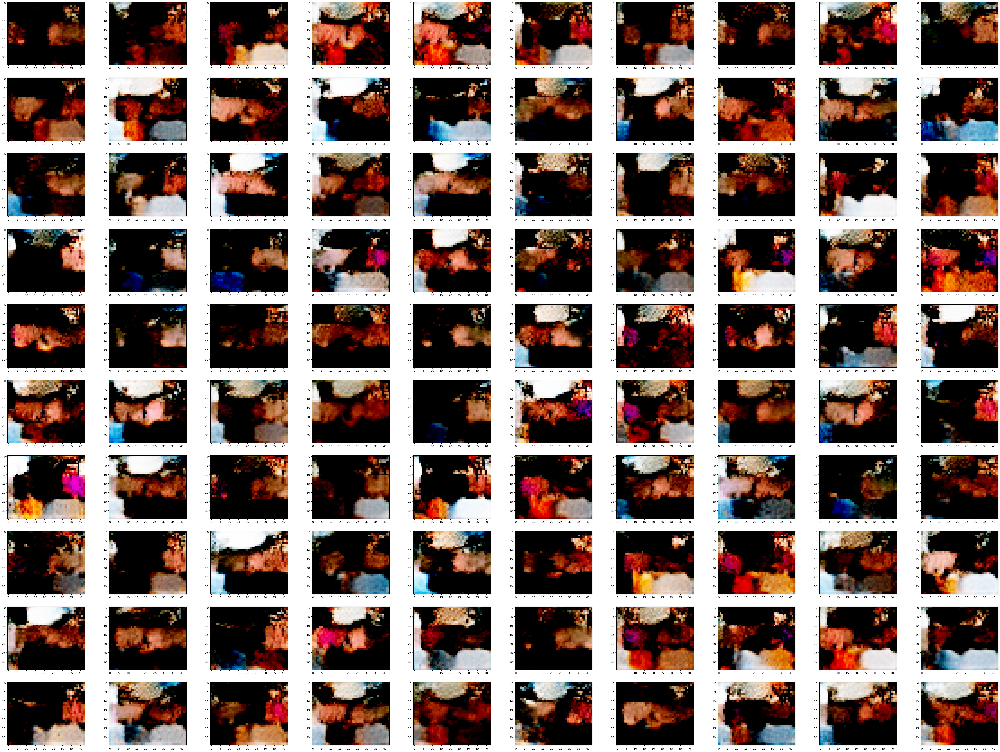

lol
Time elapsed: 722.57 min
Epoch: 020/030 | Batch 000/1582 | Gen/Dis Loss: 0.5574/0.5871
Epoch: 020/030 | Batch 100/1582 | Gen/Dis Loss: 0.8020/0.5956
Epoch: 020/030 | Batch 200/1582 | Gen/Dis Loss: 0.7614/0.5911
Epoch: 020/030 | Batch 300/1582 | Gen/Dis Loss: 0.9119/0.5859
Epoch: 020/030 | Batch 400/1582 | Gen/Dis Loss: 0.8294/0.5825
Epoch: 020/030 | Batch 500/1582 | Gen/Dis Loss: 0.8339/0.6044
Epoch: 020/030 | Batch 600/1582 | Gen/Dis Loss: 0.9157/0.5911
Epoch: 020/030 | Batch 700/1582 | Gen/Dis Loss: 0.8500/0.6056
Epoch: 020/030 | Batch 800/1582 | Gen/Dis Loss: 0.7273/0.6012
Epoch: 020/030 | Batch 900/1582 | Gen/Dis Loss: 0.7777/0.6103
Epoch: 020/030 | Batch 1000/1582 | Gen/Dis Loss: 0.8307/0.5967
Epoch: 020/030 | Batch 1100/1582 | Gen/Dis Loss: 0.7539/0.5920
Epoch: 020/030 | Batch 1200/1582 | Gen/Dis Loss: 0.7336/0.5925
Epoch: 020/030 | Batch 1300/1582 | Gen/Dis Loss: 0.9168/0.5993
Epoch: 020/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7882/0.5850
Epoch: 020/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

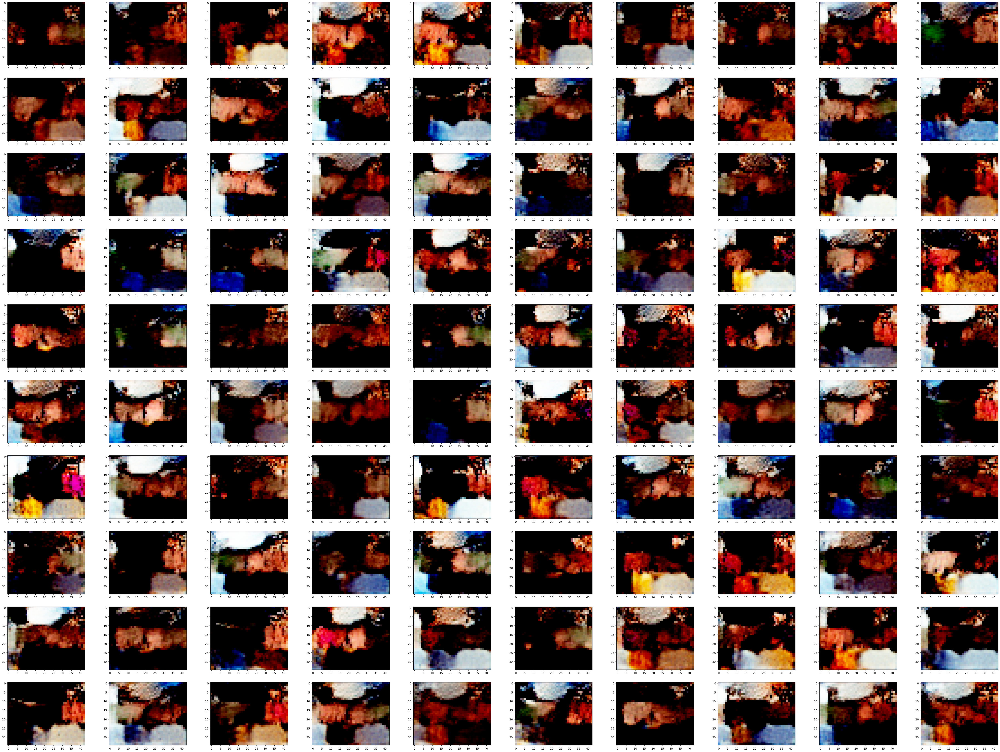

lol
Time elapsed: 760.68 min
Epoch: 021/030 | Batch 000/1582 | Gen/Dis Loss: 0.6293/0.5963
Epoch: 021/030 | Batch 100/1582 | Gen/Dis Loss: 0.7569/0.5989
Epoch: 021/030 | Batch 200/1582 | Gen/Dis Loss: 0.6875/0.6106
Epoch: 021/030 | Batch 300/1582 | Gen/Dis Loss: 0.8046/0.6074
Epoch: 021/030 | Batch 400/1582 | Gen/Dis Loss: 0.8841/0.5847
Epoch: 021/030 | Batch 500/1582 | Gen/Dis Loss: 0.8122/0.6031
Epoch: 021/030 | Batch 600/1582 | Gen/Dis Loss: 0.8619/0.5897
Epoch: 021/030 | Batch 700/1582 | Gen/Dis Loss: 0.8757/0.5822
Epoch: 021/030 | Batch 800/1582 | Gen/Dis Loss: 0.7473/0.6030
Epoch: 021/030 | Batch 900/1582 | Gen/Dis Loss: 0.8038/0.5948
Epoch: 021/030 | Batch 1000/1582 | Gen/Dis Loss: 0.8519/0.6003
Epoch: 021/030 | Batch 1100/1582 | Gen/Dis Loss: 0.7954/0.5886
Epoch: 021/030 | Batch 1200/1582 | Gen/Dis Loss: 0.6727/0.6020
Epoch: 021/030 | Batch 1300/1582 | Gen/Dis Loss: 0.8939/0.6112
Epoch: 021/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7892/0.6005
Epoch: 021/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

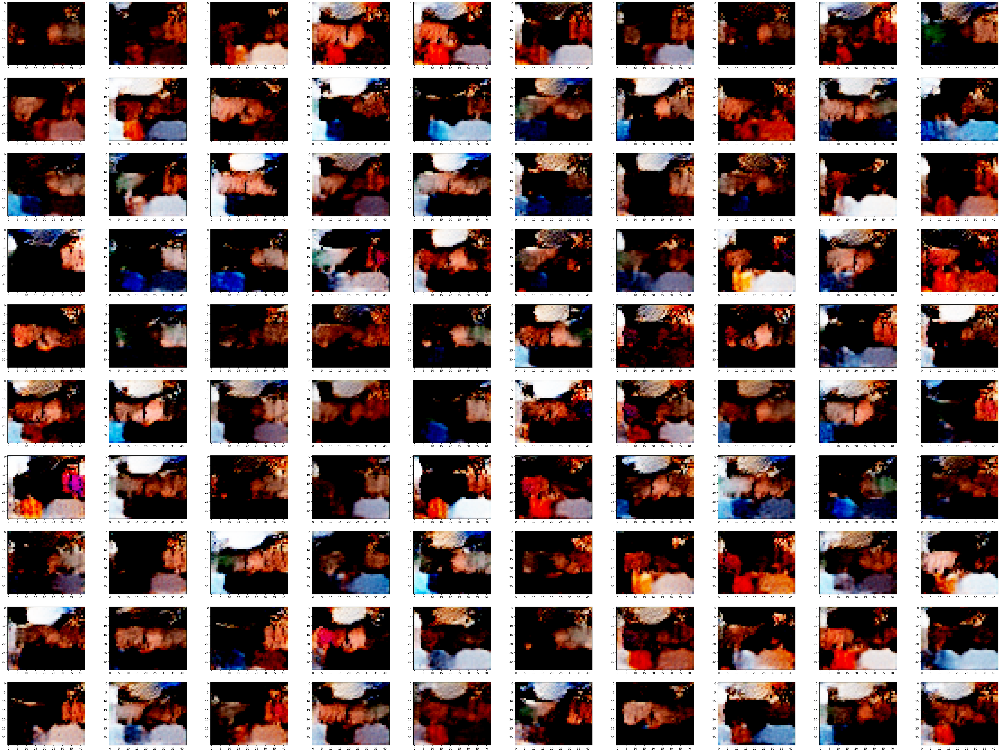

lol
Time elapsed: 798.76 min
Epoch: 022/030 | Batch 000/1582 | Gen/Dis Loss: 0.7453/0.6021
Epoch: 022/030 | Batch 100/1582 | Gen/Dis Loss: 0.7542/0.5911
Epoch: 022/030 | Batch 200/1582 | Gen/Dis Loss: 0.7848/0.5923
Epoch: 022/030 | Batch 300/1582 | Gen/Dis Loss: 0.8116/0.6078
Epoch: 022/030 | Batch 400/1582 | Gen/Dis Loss: 0.8321/0.6067
Epoch: 022/030 | Batch 500/1582 | Gen/Dis Loss: 0.8887/0.5973
Epoch: 022/030 | Batch 600/1582 | Gen/Dis Loss: 0.9007/0.5934
Epoch: 022/030 | Batch 700/1582 | Gen/Dis Loss: 0.8778/0.6070
Epoch: 022/030 | Batch 800/1582 | Gen/Dis Loss: 0.7258/0.6131
Epoch: 022/030 | Batch 900/1582 | Gen/Dis Loss: 0.7383/0.6171
Epoch: 022/030 | Batch 1000/1582 | Gen/Dis Loss: 0.7673/0.5996
Epoch: 022/030 | Batch 1100/1582 | Gen/Dis Loss: 0.6912/0.5960
Epoch: 022/030 | Batch 1200/1582 | Gen/Dis Loss: 0.6428/0.6068
Epoch: 022/030 | Batch 1300/1582 | Gen/Dis Loss: 0.8402/0.6017
Epoch: 022/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7422/0.5882
Epoch: 022/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

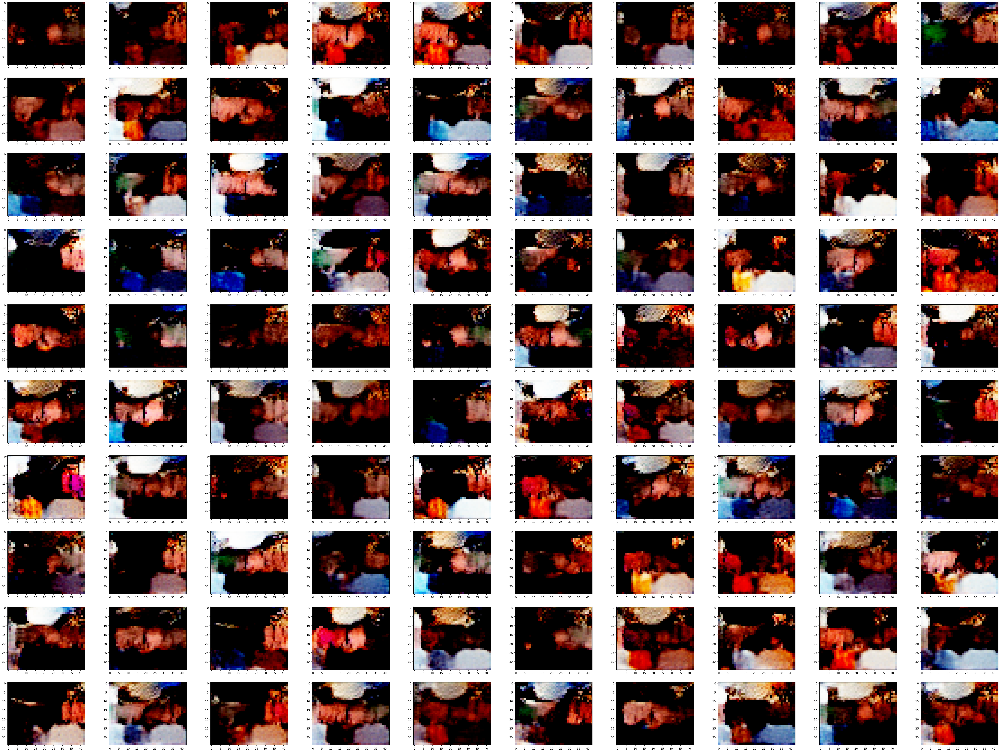

lol
Time elapsed: 836.86 min
Epoch: 023/030 | Batch 000/1582 | Gen/Dis Loss: 0.5158/0.6249
Epoch: 023/030 | Batch 100/1582 | Gen/Dis Loss: 0.7509/0.5859
Epoch: 023/030 | Batch 200/1582 | Gen/Dis Loss: 0.7099/0.6024
Epoch: 023/030 | Batch 300/1582 | Gen/Dis Loss: 0.8810/0.6324
Epoch: 023/030 | Batch 400/1582 | Gen/Dis Loss: 0.8581/0.5939
Epoch: 023/030 | Batch 500/1582 | Gen/Dis Loss: 0.7920/0.5973
Epoch: 023/030 | Batch 600/1582 | Gen/Dis Loss: 0.9515/0.5819
Epoch: 023/030 | Batch 700/1582 | Gen/Dis Loss: 0.8901/0.5937
Epoch: 023/030 | Batch 800/1582 | Gen/Dis Loss: 0.7296/0.6310
Epoch: 023/030 | Batch 900/1582 | Gen/Dis Loss: 0.7862/0.6166
Epoch: 023/030 | Batch 1000/1582 | Gen/Dis Loss: 0.8403/0.6029
Epoch: 023/030 | Batch 1100/1582 | Gen/Dis Loss: 0.7486/0.6062
Epoch: 023/030 | Batch 1200/1582 | Gen/Dis Loss: 0.7357/0.5976
Epoch: 023/030 | Batch 1300/1582 | Gen/Dis Loss: 0.8941/0.6038
Epoch: 023/030 | Batch 1400/1582 | Gen/Dis Loss: 0.8209/0.5939
Epoch: 023/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

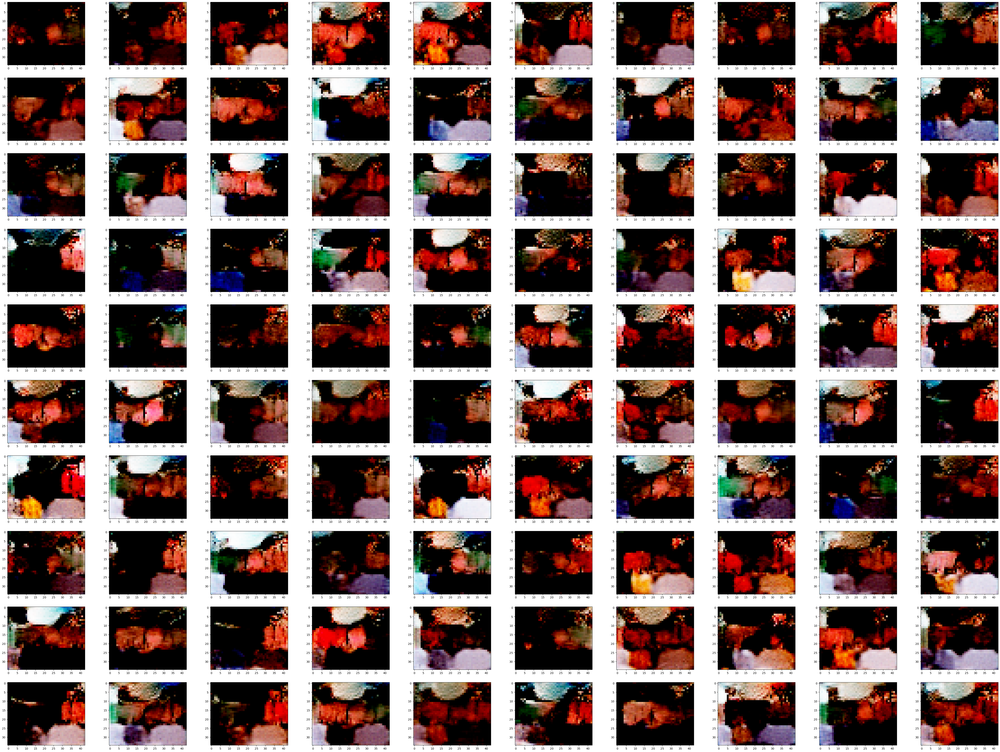

lol
Time elapsed: 875.03 min
Epoch: 024/030 | Batch 000/1582 | Gen/Dis Loss: 0.5190/0.5881
Epoch: 024/030 | Batch 100/1582 | Gen/Dis Loss: 0.7404/0.6027
Epoch: 024/030 | Batch 200/1582 | Gen/Dis Loss: 0.7655/0.6217
Epoch: 024/030 | Batch 300/1582 | Gen/Dis Loss: 0.8665/0.6125
Epoch: 024/030 | Batch 400/1582 | Gen/Dis Loss: 0.7612/0.6100
Epoch: 024/030 | Batch 500/1582 | Gen/Dis Loss: 0.8150/0.6035
Epoch: 024/030 | Batch 600/1582 | Gen/Dis Loss: 0.9202/0.5949
Epoch: 024/030 | Batch 700/1582 | Gen/Dis Loss: 0.8001/0.5970
Epoch: 024/030 | Batch 800/1582 | Gen/Dis Loss: 0.6700/0.6209
Epoch: 024/030 | Batch 900/1582 | Gen/Dis Loss: 0.8174/0.6169
Epoch: 024/030 | Batch 1000/1582 | Gen/Dis Loss: 0.8698/0.6072
Epoch: 024/030 | Batch 1100/1582 | Gen/Dis Loss: 0.7628/0.5979
Epoch: 024/030 | Batch 1200/1582 | Gen/Dis Loss: 0.7542/0.6050
Epoch: 024/030 | Batch 1300/1582 | Gen/Dis Loss: 0.9275/0.6116
Epoch: 024/030 | Batch 1400/1582 | Gen/Dis Loss: 0.8099/0.5911
Epoch: 024/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

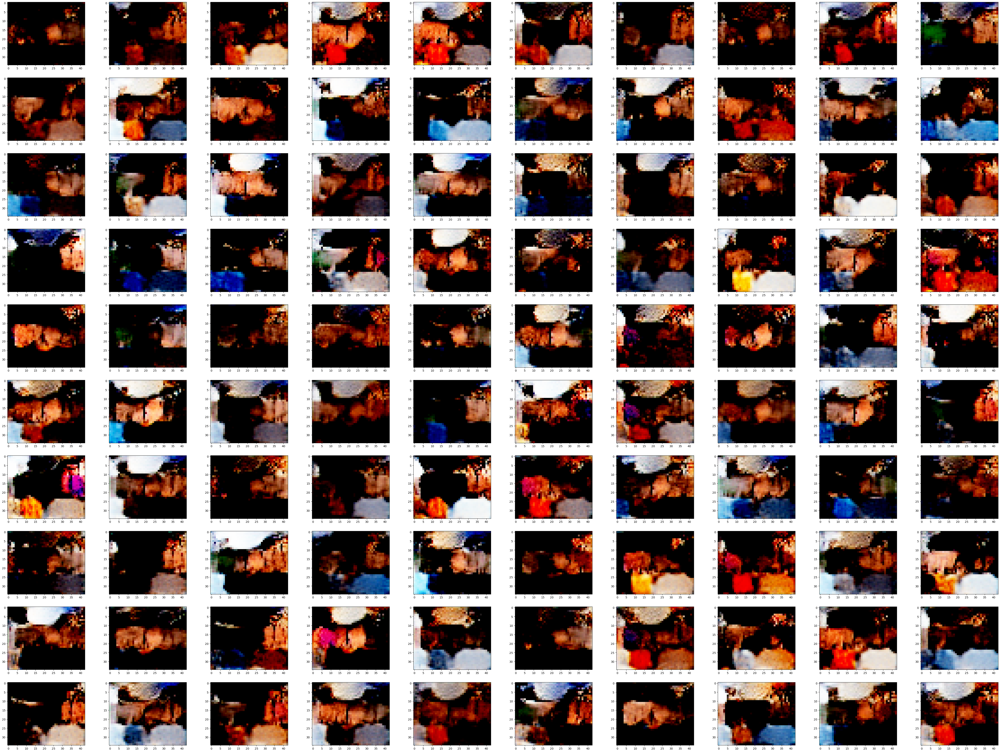

lol
Time elapsed: 913.11 min
Epoch: 025/030 | Batch 000/1582 | Gen/Dis Loss: 0.5344/0.5952
Epoch: 025/030 | Batch 100/1582 | Gen/Dis Loss: 0.7360/0.5975
Epoch: 025/030 | Batch 200/1582 | Gen/Dis Loss: 0.7246/0.6001
Epoch: 025/030 | Batch 300/1582 | Gen/Dis Loss: 0.8416/0.6269
Epoch: 025/030 | Batch 400/1582 | Gen/Dis Loss: 0.7553/0.6043
Epoch: 025/030 | Batch 500/1582 | Gen/Dis Loss: 0.8460/0.5980
Epoch: 025/030 | Batch 600/1582 | Gen/Dis Loss: 0.9440/0.5817
Epoch: 025/030 | Batch 700/1582 | Gen/Dis Loss: 0.9669/0.5852
Epoch: 025/030 | Batch 800/1582 | Gen/Dis Loss: 0.6734/0.6151
Epoch: 025/030 | Batch 900/1582 | Gen/Dis Loss: 0.8137/0.6152
Epoch: 025/030 | Batch 1000/1582 | Gen/Dis Loss: 0.8237/0.5882
Epoch: 025/030 | Batch 1100/1582 | Gen/Dis Loss: 0.7912/0.5823
Epoch: 025/030 | Batch 1200/1582 | Gen/Dis Loss: 0.7109/0.5967
Epoch: 025/030 | Batch 1300/1582 | Gen/Dis Loss: 0.8871/0.5948
Epoch: 025/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7963/0.5885
Epoch: 025/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

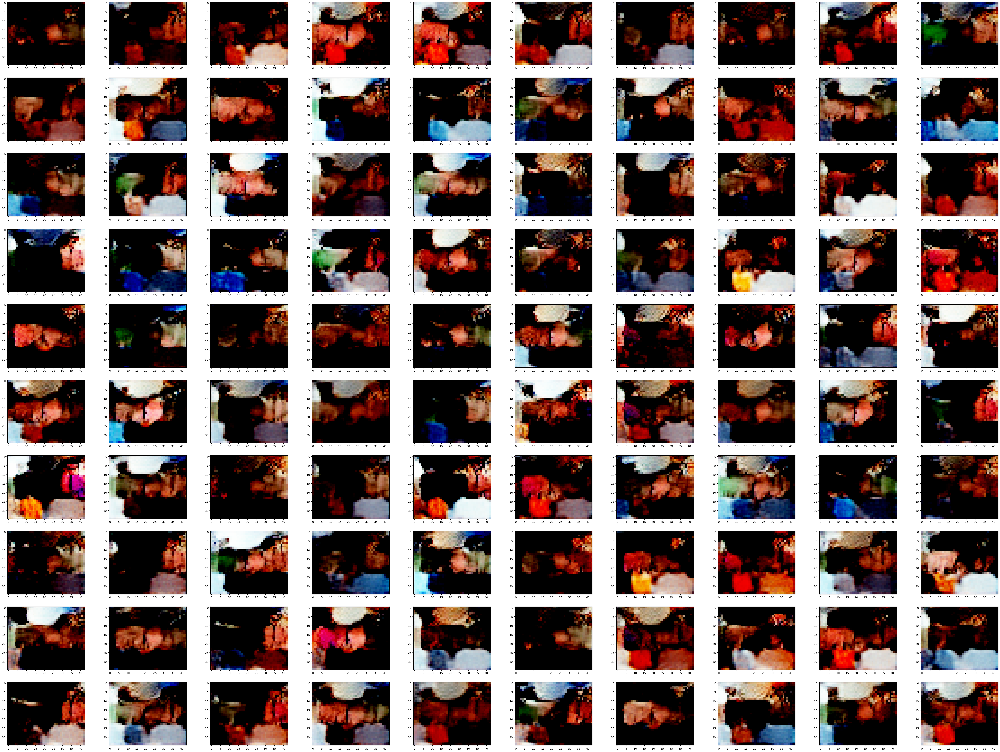

lol
Time elapsed: 951.26 min
Epoch: 026/030 | Batch 000/1582 | Gen/Dis Loss: 0.6554/0.6102
Epoch: 026/030 | Batch 100/1582 | Gen/Dis Loss: 0.8685/0.5777
Epoch: 026/030 | Batch 200/1582 | Gen/Dis Loss: 0.7195/0.6154
Epoch: 026/030 | Batch 300/1582 | Gen/Dis Loss: 0.8440/0.6298
Epoch: 026/030 | Batch 400/1582 | Gen/Dis Loss: 0.9721/0.6027
Epoch: 026/030 | Batch 500/1582 | Gen/Dis Loss: 0.8120/0.6041
Epoch: 026/030 | Batch 600/1582 | Gen/Dis Loss: 1.0188/0.5840
Epoch: 026/030 | Batch 700/1582 | Gen/Dis Loss: 0.8245/0.6086
Epoch: 026/030 | Batch 800/1582 | Gen/Dis Loss: 0.7114/0.6073
Epoch: 026/030 | Batch 900/1582 | Gen/Dis Loss: 0.7506/0.6205
Epoch: 026/030 | Batch 1000/1582 | Gen/Dis Loss: 0.8463/0.6039
Epoch: 026/030 | Batch 1100/1582 | Gen/Dis Loss: 0.7725/0.6018
Epoch: 026/030 | Batch 1200/1582 | Gen/Dis Loss: 0.6778/0.6059
Epoch: 026/030 | Batch 1300/1582 | Gen/Dis Loss: 0.9146/0.5975
Epoch: 026/030 | Batch 1400/1582 | Gen/Dis Loss: 0.8011/0.6015
Epoch: 026/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

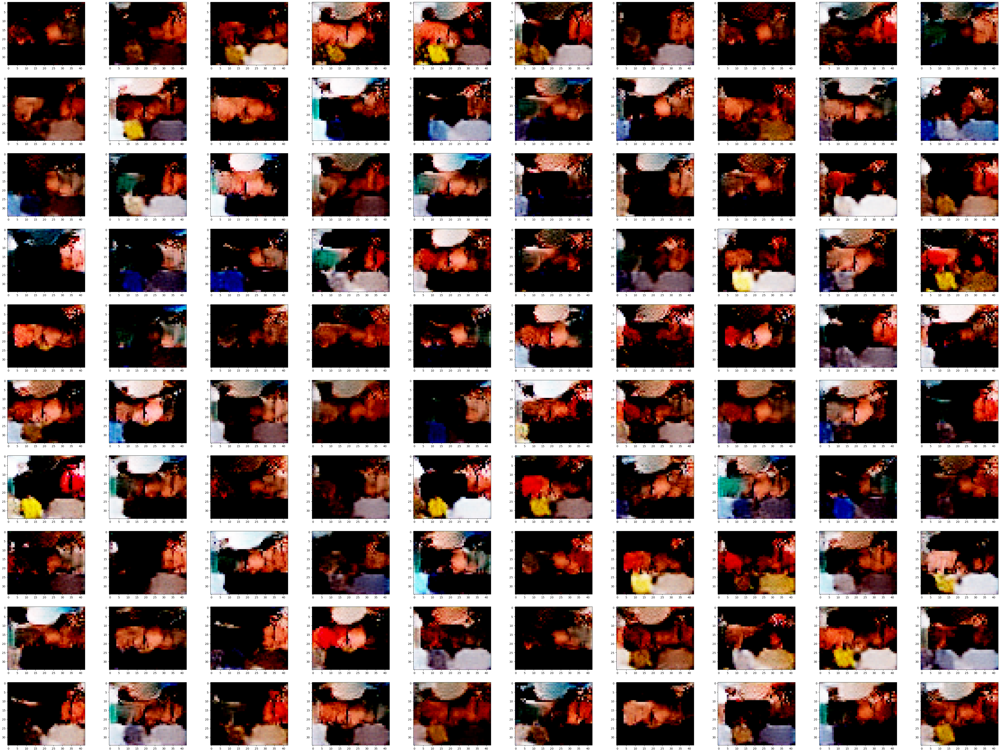

lol
Time elapsed: 989.37 min
Epoch: 027/030 | Batch 000/1582 | Gen/Dis Loss: 0.5191/0.6026
Epoch: 027/030 | Batch 100/1582 | Gen/Dis Loss: 0.7584/0.5923
Epoch: 027/030 | Batch 200/1582 | Gen/Dis Loss: 0.7148/0.6033
Epoch: 027/030 | Batch 300/1582 | Gen/Dis Loss: 1.0241/0.6368
Epoch: 027/030 | Batch 400/1582 | Gen/Dis Loss: 0.8350/0.5952
Epoch: 027/030 | Batch 500/1582 | Gen/Dis Loss: 0.8031/0.5989
Epoch: 027/030 | Batch 600/1582 | Gen/Dis Loss: 0.9707/0.5929
Epoch: 027/030 | Batch 700/1582 | Gen/Dis Loss: 0.8221/0.5975
Epoch: 027/030 | Batch 800/1582 | Gen/Dis Loss: 0.7283/0.6088
Epoch: 027/030 | Batch 900/1582 | Gen/Dis Loss: 0.8002/0.6285
Epoch: 027/030 | Batch 1000/1582 | Gen/Dis Loss: 0.9868/0.5837
Epoch: 027/030 | Batch 1100/1582 | Gen/Dis Loss: 0.7403/0.6078
Epoch: 027/030 | Batch 1200/1582 | Gen/Dis Loss: 0.7748/0.5999
Epoch: 027/030 | Batch 1300/1582 | Gen/Dis Loss: 0.8254/0.6167
Epoch: 027/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7602/0.6083
Epoch: 027/030 | Batch 1500/1582 | G

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

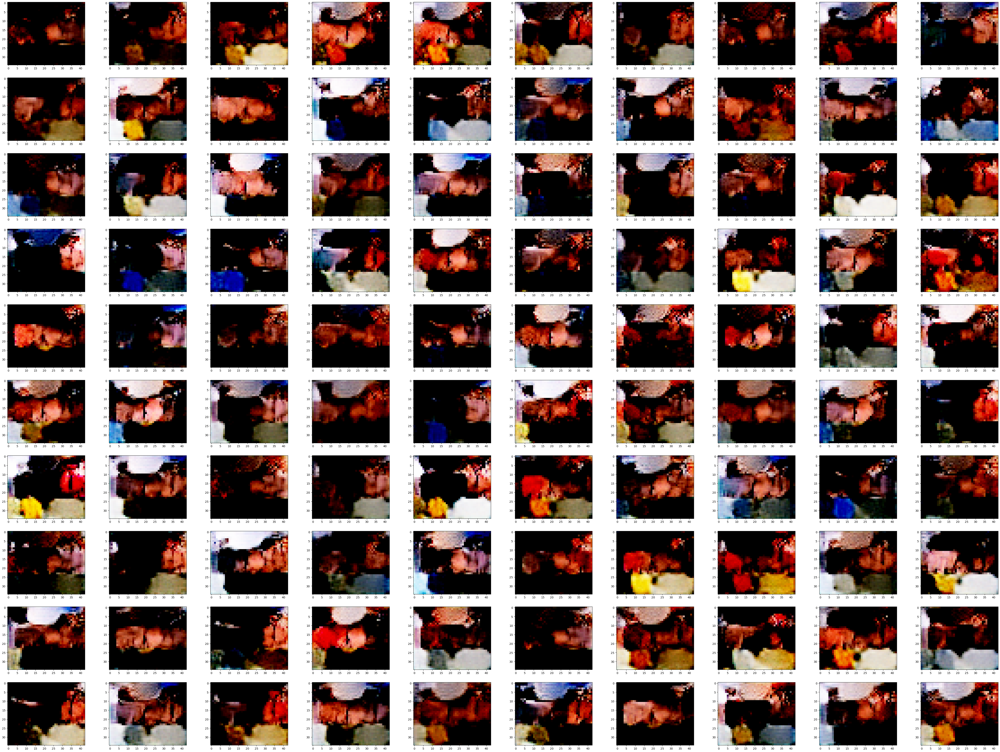

lol
Time elapsed: 1027.35 min
Epoch: 028/030 | Batch 000/1582 | Gen/Dis Loss: 0.7275/0.6119
Epoch: 028/030 | Batch 100/1582 | Gen/Dis Loss: 0.7444/0.5915
Epoch: 028/030 | Batch 200/1582 | Gen/Dis Loss: 0.6513/0.6125
Epoch: 028/030 | Batch 300/1582 | Gen/Dis Loss: 1.1379/0.6424
Epoch: 028/030 | Batch 400/1582 | Gen/Dis Loss: 1.0311/0.5809
Epoch: 028/030 | Batch 500/1582 | Gen/Dis Loss: 0.8960/0.6219
Epoch: 028/030 | Batch 600/1582 | Gen/Dis Loss: 0.8389/0.6001
Epoch: 028/030 | Batch 700/1582 | Gen/Dis Loss: 0.8527/0.6000
Epoch: 028/030 | Batch 800/1582 | Gen/Dis Loss: 0.6973/0.6147
Epoch: 028/030 | Batch 900/1582 | Gen/Dis Loss: 0.7532/0.6200
Epoch: 028/030 | Batch 1000/1582 | Gen/Dis Loss: 0.9070/0.5947
Epoch: 028/030 | Batch 1100/1582 | Gen/Dis Loss: 0.8220/0.5857
Epoch: 028/030 | Batch 1200/1582 | Gen/Dis Loss: 0.7032/0.5994
Epoch: 028/030 | Batch 1300/1582 | Gen/Dis Loss: 0.9253/0.6076
Epoch: 028/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7149/0.6050
Epoch: 028/030 | Batch 1500/1582 | 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

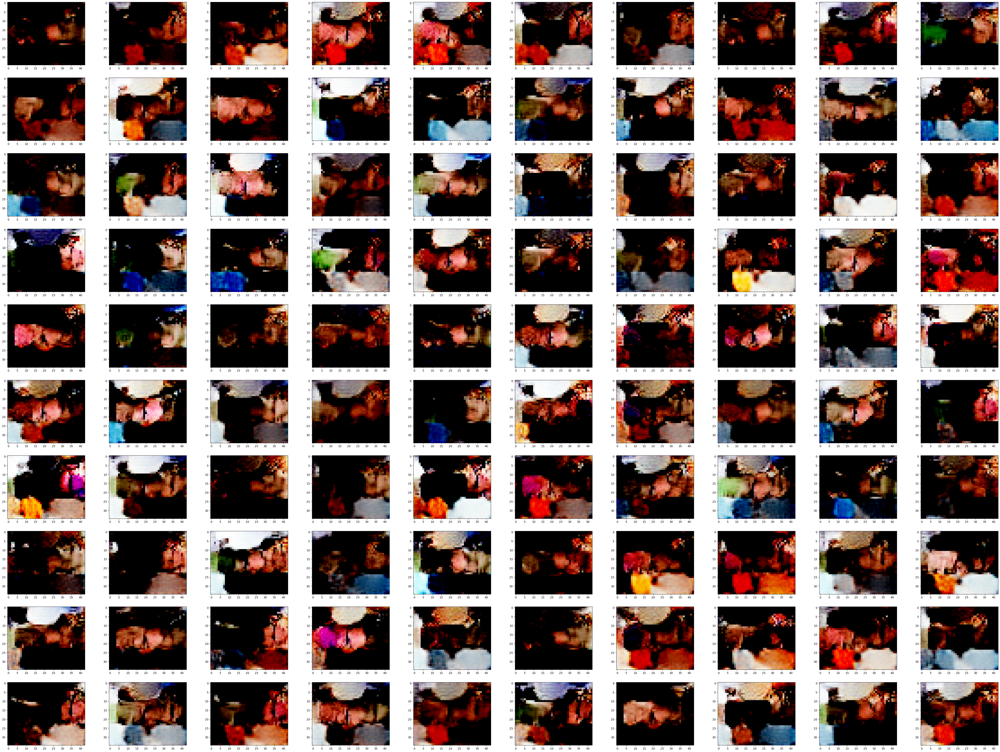

lol
Time elapsed: 1065.53 min
Epoch: 029/030 | Batch 000/1582 | Gen/Dis Loss: 0.6192/0.5994
Epoch: 029/030 | Batch 100/1582 | Gen/Dis Loss: 0.7978/0.5805
Epoch: 029/030 | Batch 200/1582 | Gen/Dis Loss: 0.5919/0.6176
Epoch: 029/030 | Batch 300/1582 | Gen/Dis Loss: 1.0290/0.6129
Epoch: 029/030 | Batch 400/1582 | Gen/Dis Loss: 0.8583/0.5890
Epoch: 029/030 | Batch 500/1582 | Gen/Dis Loss: 0.8633/0.6049
Epoch: 029/030 | Batch 600/1582 | Gen/Dis Loss: 0.9094/0.5934
Epoch: 029/030 | Batch 700/1582 | Gen/Dis Loss: 0.7969/0.5992
Epoch: 029/030 | Batch 800/1582 | Gen/Dis Loss: 0.7184/0.6182
Epoch: 029/030 | Batch 900/1582 | Gen/Dis Loss: 0.7619/0.6206
Epoch: 029/030 | Batch 1000/1582 | Gen/Dis Loss: 0.8830/0.5978
Epoch: 029/030 | Batch 1100/1582 | Gen/Dis Loss: 0.7617/0.6044
Epoch: 029/030 | Batch 1200/1582 | Gen/Dis Loss: 0.7766/0.5989
Epoch: 029/030 | Batch 1300/1582 | Gen/Dis Loss: 0.8100/0.6020
Epoch: 029/030 | Batch 1400/1582 | Gen/Dis Loss: 0.7300/0.5991
Epoch: 029/030 | Batch 1500/1582 | 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

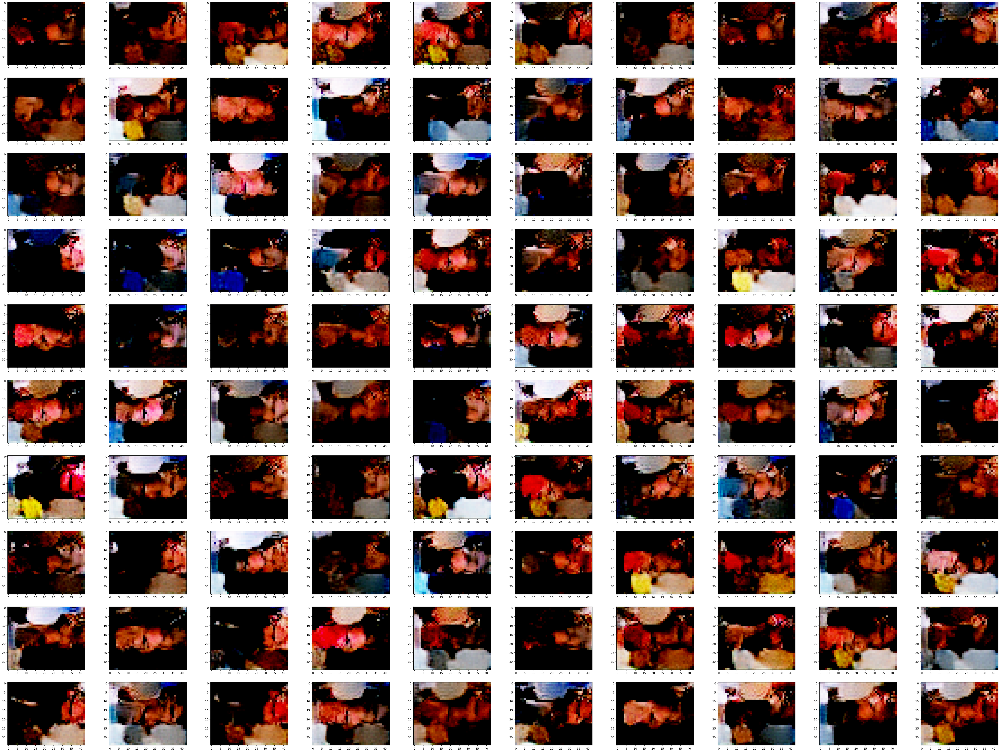

lol
Time elapsed: 1103.70 min
Epoch: 030/030 | Batch 000/1582 | Gen/Dis Loss: 0.6637/0.6028
Epoch: 030/030 | Batch 100/1582 | Gen/Dis Loss: 0.8317/0.5880
Epoch: 030/030 | Batch 200/1582 | Gen/Dis Loss: 0.6730/0.6220
Epoch: 030/030 | Batch 300/1582 | Gen/Dis Loss: 0.9317/0.6069
Epoch: 030/030 | Batch 400/1582 | Gen/Dis Loss: 0.8339/0.5973
Epoch: 030/030 | Batch 500/1582 | Gen/Dis Loss: 0.8203/0.5992
Epoch: 030/030 | Batch 600/1582 | Gen/Dis Loss: 0.9010/0.6068
Epoch: 030/030 | Batch 700/1582 | Gen/Dis Loss: 0.7812/0.6131
Epoch: 030/030 | Batch 800/1582 | Gen/Dis Loss: 0.7793/0.6155
Epoch: 030/030 | Batch 900/1582 | Gen/Dis Loss: 0.7803/0.6033
Epoch: 030/030 | Batch 1000/1582 | Gen/Dis Loss: 0.8636/0.5892
Epoch: 030/030 | Batch 1100/1582 | Gen/Dis Loss: 0.7158/0.6113
Epoch: 030/030 | Batch 1200/1582 | Gen/Dis Loss: 0.8276/0.5893
Epoch: 030/030 | Batch 1300/1582 | Gen/Dis Loss: 0.8597/0.6058
Epoch: 030/030 | Batch 1400/1582 | Gen/Dis Loss: 0.8341/0.5971
Epoch: 030/030 | Batch 1500/1582 | 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

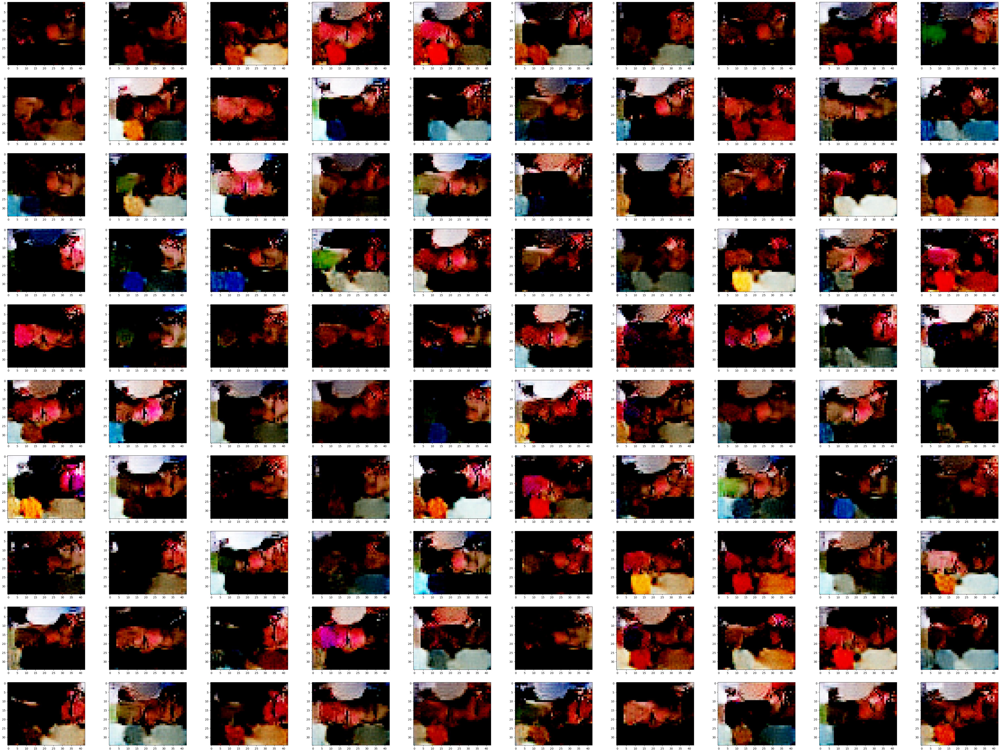

lol
Time elapsed: 1141.86 min
Total Training Time: 1141.86 min


In [9]:
# DEVICE = ['cuda:0', 'cuda:1']

NUM_EPOCHS=30
model=GAN_res1(num_features=10,batch_size=batch_size)
# model.load_state_dict(torch.load("../input/gan-celeba011/gan_celeba_01 (3).pt"))

torch.cuda.empty_cache()
log_dict = train_gan_v1(num_epochs=NUM_EPOCHS, model=model, 
#                         optimizer_gen=optim_gen,
#                         optimizer_discr=optim_discr,
                        latent_dim=10,
                        # device=DEVICE, 
                        train_loader=train_loader,
                        logging_interval=100,
                        save_model='gan_celeba_xd.pt')

In [10]:
import os,ssl,smtplib
from email.mime.multipart import MIMEMultipart
from email.mime.base import MIMEBase
from email.message import EmailMessage
from email import encoders

em  = MIMEMultipart()
em['From'] = 'm.baryla00001@gmail.com'
em['To'] = 'm.baryla001@gmail.com'
em['Subcject'] = 'test'

with open('./delete.py', "rb") as attachment:
    part = MIMEBase("application", "octet-stream")
    part.set_payload(attachment.read())

encoders.encode_base64(part)

# Add header as key/value pair to attachment part
part.add_header(
    "Content-Disposition",
    f"attachment; filename= {'./gan_celeba_xd.pt'}",
)

# Add attachment to message and convert message to string
em.attach(part)
text = em.as_string()

# Log in to server using secure context and send email
context = ssl.create_default_context()
with smtplib.SMTP_SSL("smtp.gmail.com", 465, context=context) as server:
    server.login('m.baryla00001@gmail.com', 'qdamvvywdyxthjqd')
    
    server.sendmail('m.baryla00001@gmail.com', 'm.baryla001@gmail.com', text)

FileNotFoundError: [Errno 2] No such file or directory: './delete.py'